In [1]:
import torch
from model.desc import ConditionalDiscriminator
from model.gen import UnetGenerator
from model.losses import GeneratorLoss,DiscriminatorLoss 
import random
import numpy as np
from torch.utils.data import DataLoader
from torchvision import transforms
from modules.dataloader import ImagePairDataset
import torch.optim as optim
from torch import nn
import torch.nn.functional as F
import matplotlib.pyplot as plt

In [2]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed) 
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

set_seed(666)

In [3]:
folder_in = 'data\src\googlesat'
folder_out = 'data\src\osm'

image_size = 256
crop_size = 256
batch_size = 32
epochs = 1000
learning_rate = 0.001

In [4]:
transform_in = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((image_size, image_size)),
    transforms.Normalize(mean=[0.5, 0.5, 0.5],
                                     std=[0.5, 0.5, 0.5])
])

transform_out = transforms.Compose([
    transforms.ToTensor(),  
    transforms.Resize((image_size, image_size)),
     transforms.Normalize(mean=[0.5, 0.5, 0.5],
                                     std=[0.5, 0.5, 0.5])
])

dataset = ImagePairDataset(folder_in, folder_out, transform_in, transform_out,(crop_size,crop_size))
dataloader = DataLoader(dataset, batch_size=32, shuffle=True,drop_last=True)

In [5]:
generator = UnetGenerator().to(device)
generator.load_state_dict(torch.load('generator_epoch.pth'))
discriminator = ConditionalDiscriminator().to(device)
discriminator.load_state_dict(torch.load('discriminator_epoch.pth'))
# optimizers
g_optimizer = torch.optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.999))
# loss functions
g_criterion = GeneratorLoss(alpha=100)
d_criterion = DiscriminatorLoss()

In [6]:
optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.5, 0.999))  # Для дискриминатора
optimizer_g = torch.optim.Adam(generator.parameters(), lr=0.0001, betas=(0.5, 0.999))  # Для генератора

criterion = nn.BCELoss()

In [7]:
def reverse_normalization(tensor_image):
    # Define the mean and std used for normalization
    mean = torch.tensor([0.5, 0.5, 0.5]).to(tensor_image.device)
    std = torch.tensor([0.5, 0.5, 0.5]).to(tensor_image.device)

    # Reverse normalization: (image * std) + mean
    tensor_image = tensor_image * std[:, None, None] + mean[:, None, None]

    # Convert from (C x H x W) to (H x W x C) for visualization
    image = tensor_image.permute(1, 2, 0).cpu().numpy()

    # Clip values to [0, 1] for visualization
    image = image.clip(0, 1)

    return image

Epoch [1/1000], D Loss: 0.0728, G Loss: 14.4321
Epoch [2/1000], D Loss: 0.0927, G Loss: 13.8857
Epoch [3/1000], D Loss: 0.0606, G Loss: 16.0074
Epoch [4/1000], D Loss: 0.0621, G Loss: 15.6920


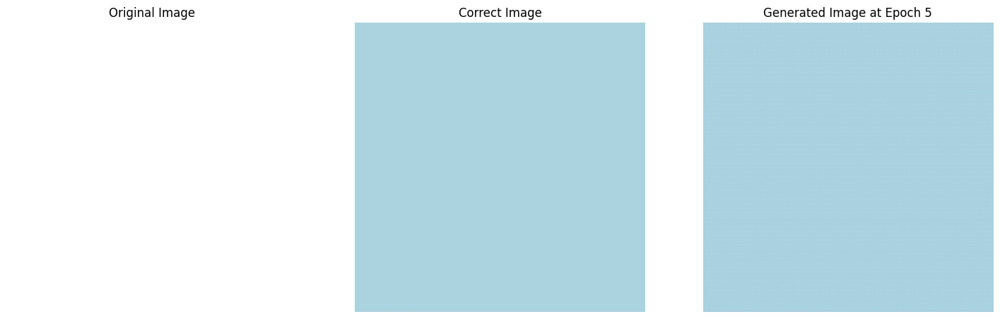

Epoch [5/1000], D Loss: 0.2263, G Loss: 12.9065
Epoch [6/1000], D Loss: 0.0874, G Loss: 13.2638
Epoch [7/1000], D Loss: 0.0623, G Loss: 13.2467
Epoch [8/1000], D Loss: 0.0447, G Loss: 13.5635
Epoch [9/1000], D Loss: 0.0639, G Loss: 12.8661


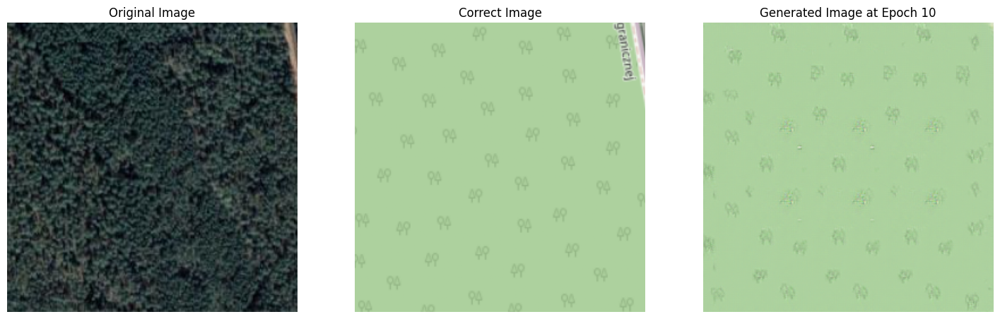

Epoch [10/1000], D Loss: 0.0822, G Loss: 13.0036
Epoch [11/1000], D Loss: 0.0480, G Loss: 13.5376
Epoch [12/1000], D Loss: 0.0782, G Loss: 13.1556
Epoch [13/1000], D Loss: 0.0695, G Loss: 12.8588
Epoch [14/1000], D Loss: 0.0751, G Loss: 13.7120


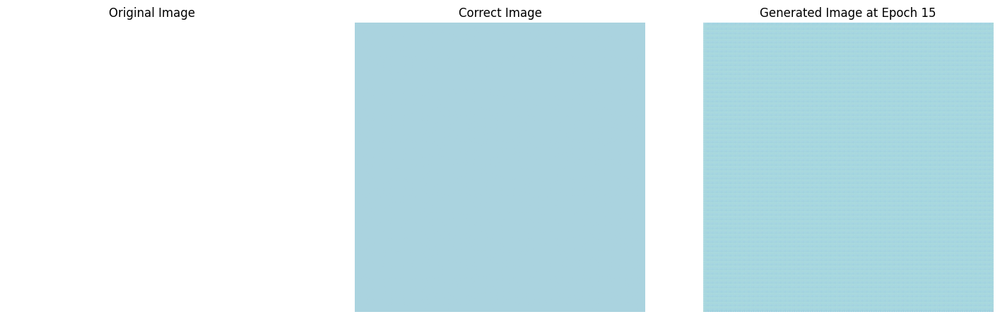

Epoch [15/1000], D Loss: 0.0536, G Loss: 15.3260
Epoch [16/1000], D Loss: 0.0878, G Loss: 14.9499
Epoch [17/1000], D Loss: 0.2706, G Loss: 12.1576
Epoch [18/1000], D Loss: 0.1206, G Loss: 12.8271
Epoch [19/1000], D Loss: 0.0944, G Loss: 13.7761


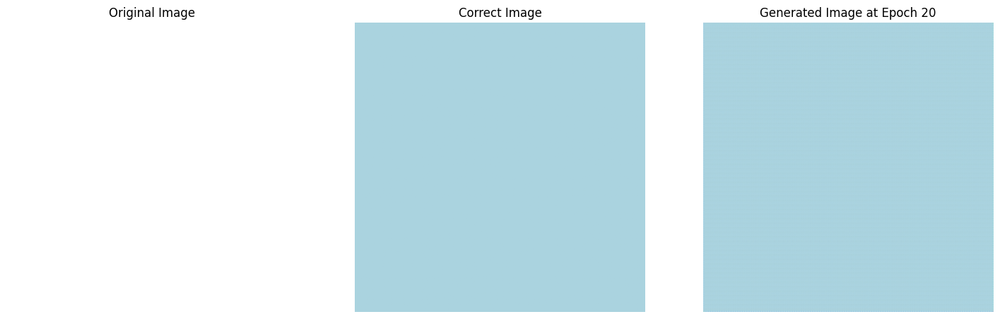

Epoch [20/1000], D Loss: 0.0665, G Loss: 13.9925
Epoch [21/1000], D Loss: 0.0931, G Loss: 12.9648
Epoch [22/1000], D Loss: 0.0799, G Loss: 12.7655
Epoch [23/1000], D Loss: 0.0946, G Loss: 13.3741
Epoch [24/1000], D Loss: 0.0967, G Loss: 14.2576


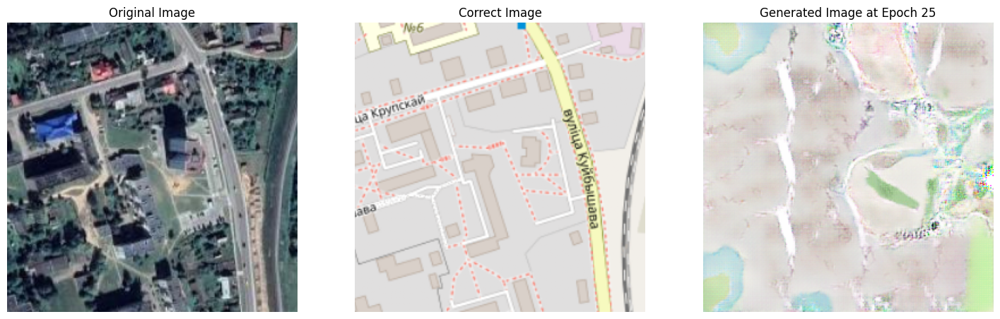

Epoch [25/1000], D Loss: 0.0725, G Loss: 15.0173
Epoch [26/1000], D Loss: 0.0567, G Loss: 14.8827
Epoch [27/1000], D Loss: 0.0671, G Loss: 15.3094
Epoch [28/1000], D Loss: 0.0618, G Loss: 15.0274
Epoch [29/1000], D Loss: 0.0870, G Loss: 16.1573


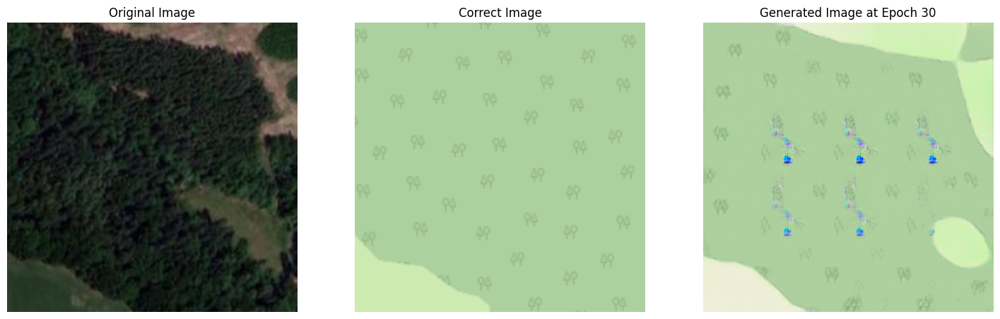

Epoch [30/1000], D Loss: 0.0631, G Loss: 14.7939
Epoch [31/1000], D Loss: 0.0734, G Loss: 13.8806
Epoch [32/1000], D Loss: 0.1298, G Loss: 13.2112
Epoch [33/1000], D Loss: 0.0802, G Loss: 12.8610
Epoch [34/1000], D Loss: 0.0775, G Loss: 13.0323


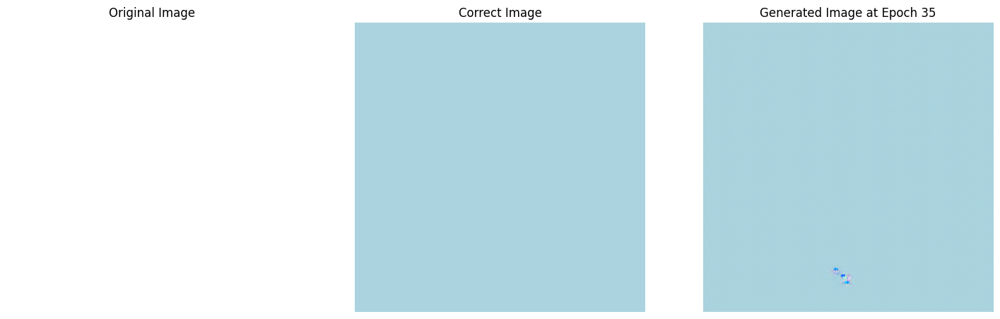

Epoch [35/1000], D Loss: 0.0744, G Loss: 12.6017
Epoch [36/1000], D Loss: 0.0700, G Loss: 12.2734
Epoch [37/1000], D Loss: 0.1221, G Loss: 12.7761
Epoch [38/1000], D Loss: 0.0793, G Loss: 12.2733
Epoch [39/1000], D Loss: 0.0832, G Loss: 12.5010


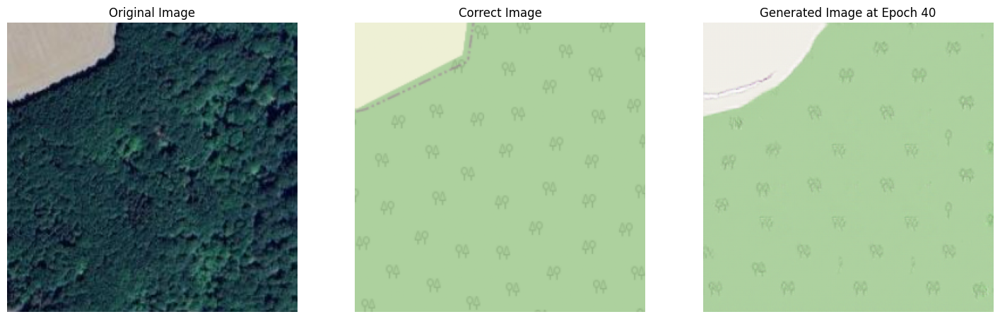

Epoch [40/1000], D Loss: 0.0851, G Loss: 12.5136
Epoch [41/1000], D Loss: 0.0648, G Loss: 12.5637
Epoch [42/1000], D Loss: 0.0596, G Loss: 12.5868
Epoch [43/1000], D Loss: 0.0678, G Loss: 12.4648
Epoch [44/1000], D Loss: 0.0872, G Loss: 13.8663


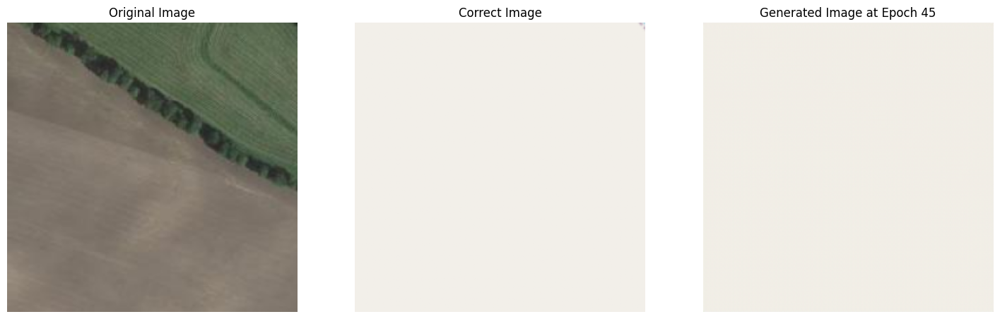

Epoch [45/1000], D Loss: 0.0768, G Loss: 14.1905
Epoch [46/1000], D Loss: 0.0836, G Loss: 13.9289
Epoch [47/1000], D Loss: 0.0754, G Loss: 12.9838
Epoch [48/1000], D Loss: 0.0793, G Loss: 13.0155
Epoch [49/1000], D Loss: 0.2266, G Loss: 14.4556


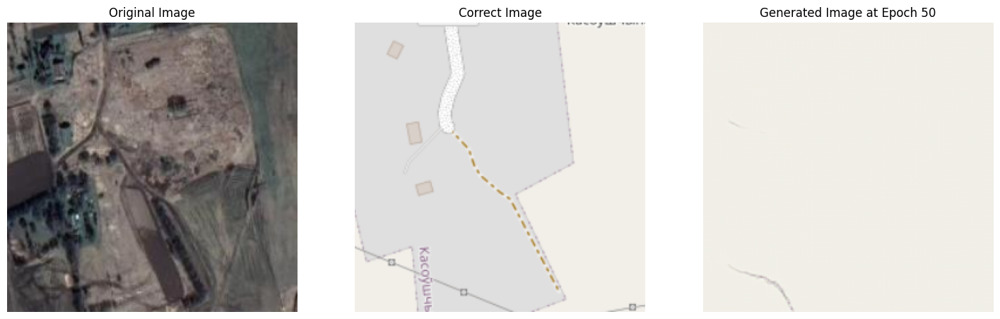

Epoch [50/1000], D Loss: 0.3016, G Loss: 12.4956
Epoch [51/1000], D Loss: 0.0685, G Loss: 13.1264
Epoch [52/1000], D Loss: 0.0626, G Loss: 13.4043
Epoch [53/1000], D Loss: 0.0648, G Loss: 13.0468
Epoch [54/1000], D Loss: 0.0450, G Loss: 14.8833


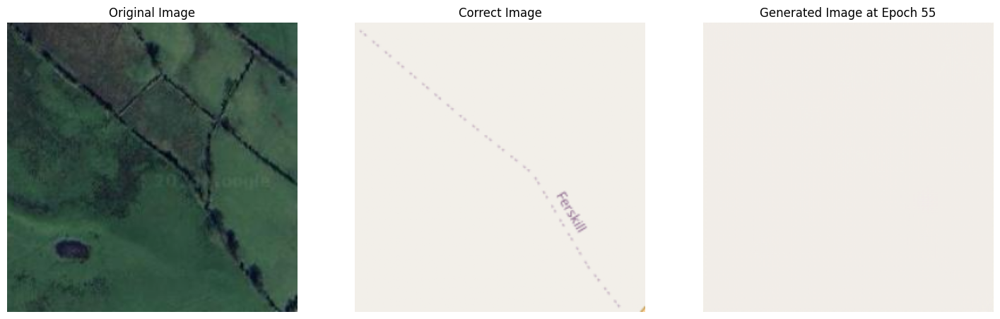

Epoch [55/1000], D Loss: 0.0571, G Loss: 13.8664
Epoch [56/1000], D Loss: 0.0577, G Loss: 13.5344
Epoch [57/1000], D Loss: 0.0683, G Loss: 13.3200
Epoch [58/1000], D Loss: 0.0774, G Loss: 14.2900
Epoch [59/1000], D Loss: 0.0871, G Loss: 13.7432


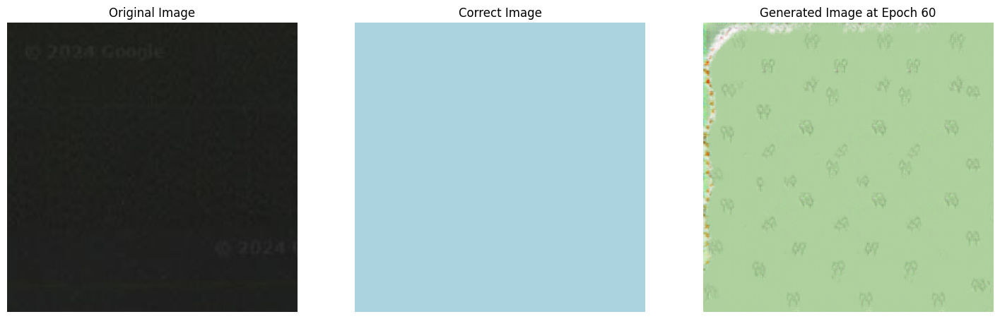

Epoch [60/1000], D Loss: 0.0711, G Loss: 14.8424
Epoch [61/1000], D Loss: 0.0823, G Loss: 18.5471
Epoch [62/1000], D Loss: 0.0702, G Loss: 18.2286
Epoch [63/1000], D Loss: 0.0706, G Loss: 19.5650
Epoch [64/1000], D Loss: 0.1354, G Loss: 20.8810


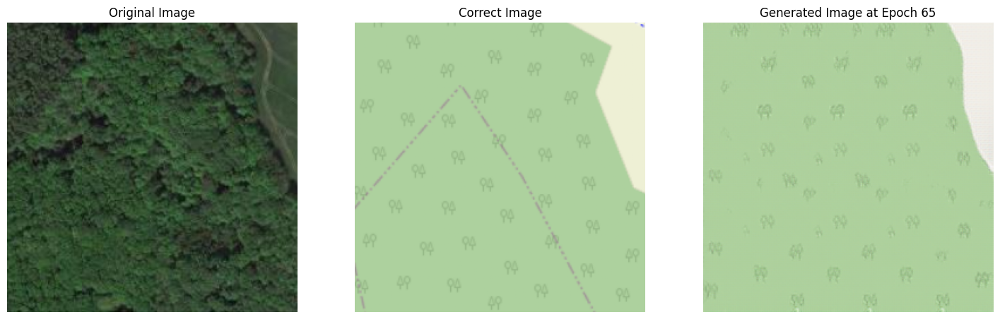

Epoch [65/1000], D Loss: 0.0675, G Loss: 14.9102
Epoch [66/1000], D Loss: 0.0712, G Loss: 14.8994
Epoch [67/1000], D Loss: 0.0684, G Loss: 14.9116
Epoch [68/1000], D Loss: 0.0607, G Loss: 14.3384
Epoch [69/1000], D Loss: 0.0651, G Loss: 13.6467


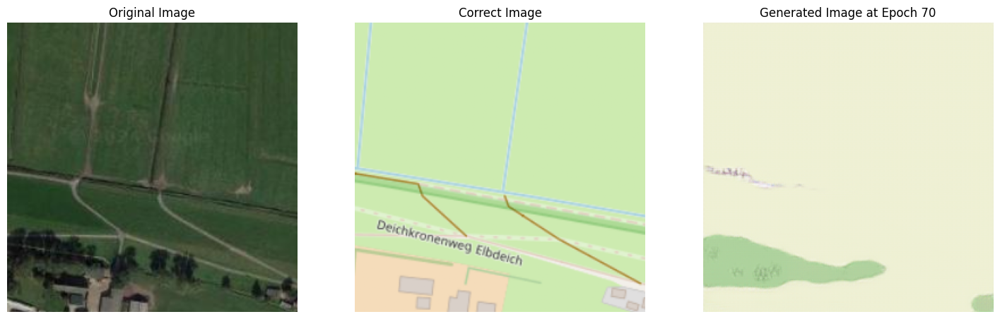

Epoch [70/1000], D Loss: 0.0602, G Loss: 13.0863
Epoch [71/1000], D Loss: 0.0828, G Loss: 12.7647
Epoch [72/1000], D Loss: 0.0848, G Loss: 13.8475
Epoch [73/1000], D Loss: 0.0788, G Loss: 15.8053
Epoch [74/1000], D Loss: 0.0629, G Loss: 14.6210


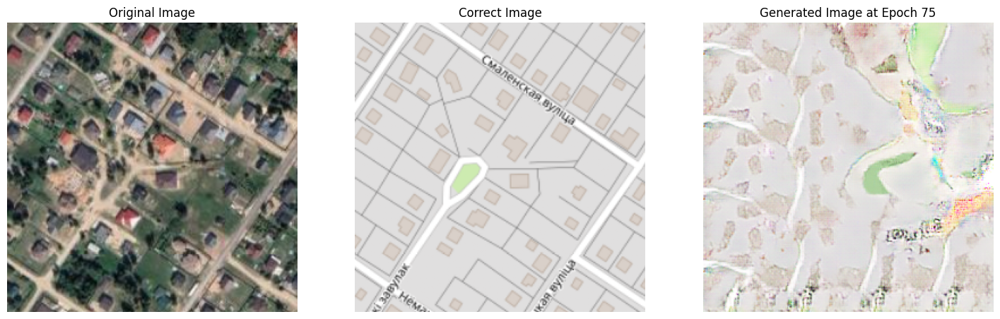

Epoch [75/1000], D Loss: 0.0511, G Loss: 14.2819
Epoch [76/1000], D Loss: 0.0720, G Loss: 13.8008
Epoch [77/1000], D Loss: 0.0632, G Loss: 13.8720
Epoch [78/1000], D Loss: 0.0542, G Loss: 13.6034
Epoch [79/1000], D Loss: 0.0639, G Loss: 13.9152


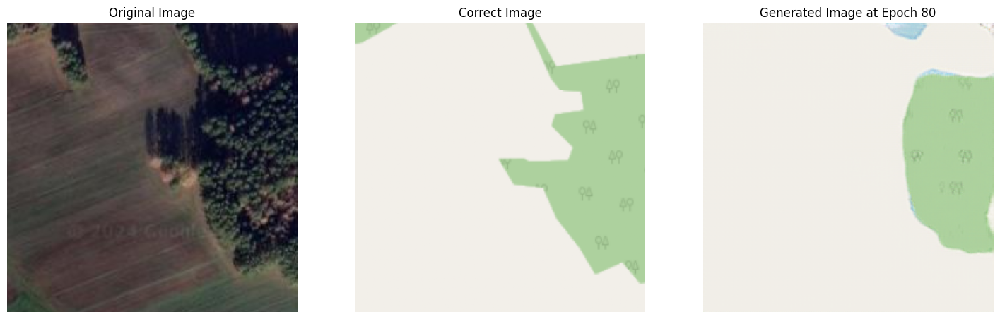

Epoch [80/1000], D Loss: 0.0543, G Loss: 14.4440
Epoch [81/1000], D Loss: 0.0585, G Loss: 13.9256
Epoch [82/1000], D Loss: 0.0648, G Loss: 14.6229
Epoch [83/1000], D Loss: 0.0678, G Loss: 14.7648
Epoch [84/1000], D Loss: 0.0442, G Loss: 14.6725


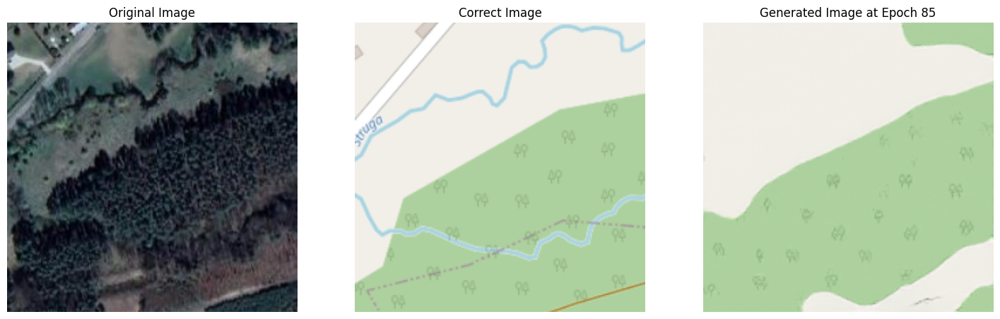

Epoch [85/1000], D Loss: 0.4428, G Loss: 13.3350
Epoch [86/1000], D Loss: 0.2701, G Loss: 11.1377
Epoch [87/1000], D Loss: 0.1839, G Loss: 12.0372
Epoch [88/1000], D Loss: 0.0716, G Loss: 12.7859
Epoch [89/1000], D Loss: 0.0630, G Loss: 13.3514


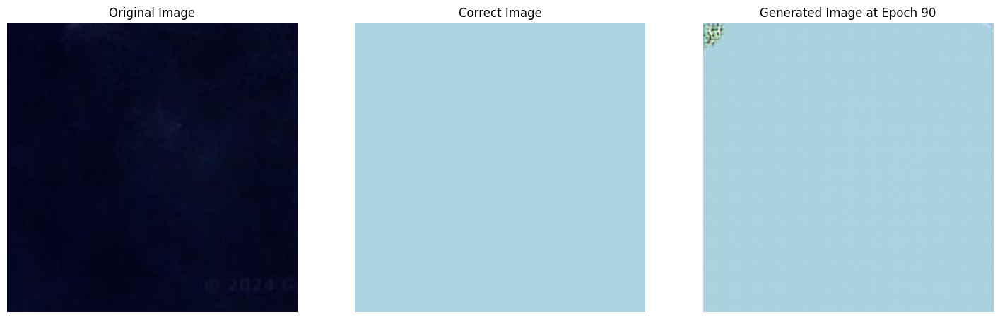

Epoch [90/1000], D Loss: 0.0616, G Loss: 13.7703
Epoch [91/1000], D Loss: 0.0570, G Loss: 14.5500
Epoch [92/1000], D Loss: 0.0534, G Loss: 13.6347
Epoch [93/1000], D Loss: 0.2928, G Loss: 11.7022
Epoch [94/1000], D Loss: 0.1192, G Loss: 12.6022


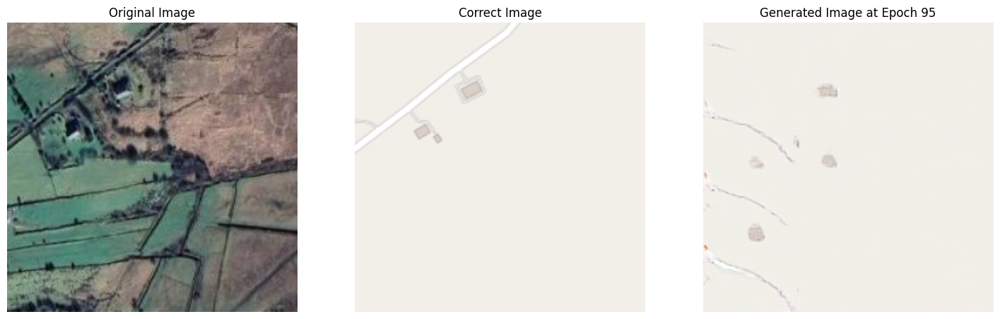

Epoch [95/1000], D Loss: 0.0757, G Loss: 13.3785
Epoch [96/1000], D Loss: 0.0706, G Loss: 13.0720
Epoch [97/1000], D Loss: 0.0542, G Loss: 14.2497
Epoch [98/1000], D Loss: 0.0947, G Loss: 12.6840
Epoch [99/1000], D Loss: 0.0650, G Loss: 14.1782


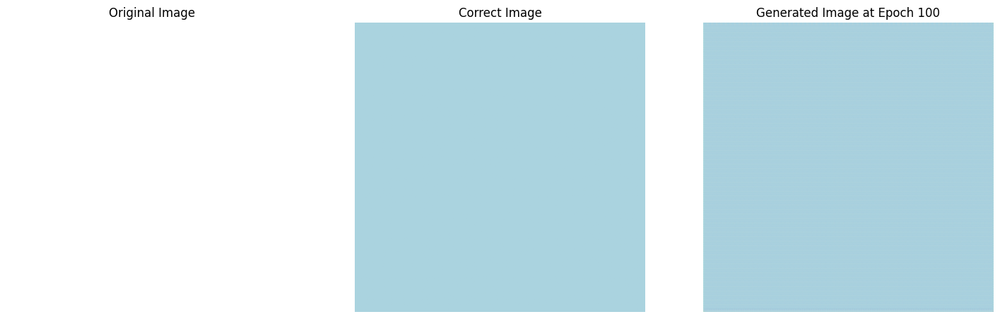

Epoch [100/1000], D Loss: 0.0444, G Loss: 14.5456
Epoch [101/1000], D Loss: 0.0533, G Loss: 13.6131
Epoch [102/1000], D Loss: 0.0568, G Loss: 13.4528
Epoch [103/1000], D Loss: 0.0631, G Loss: 13.9119
Epoch [104/1000], D Loss: 0.0970, G Loss: 13.6687


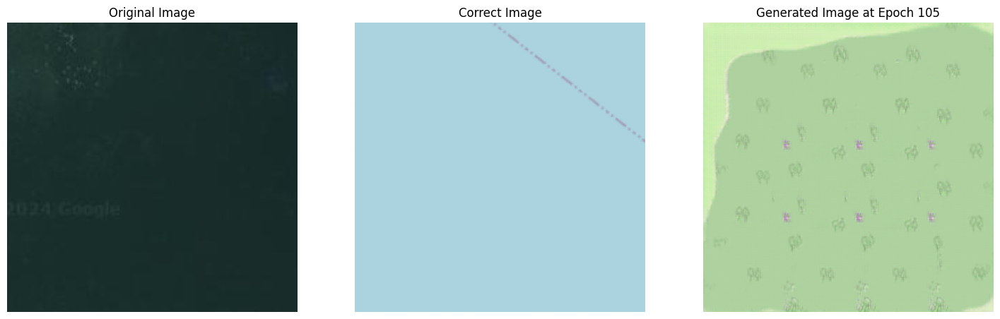

Epoch [105/1000], D Loss: 0.0712, G Loss: 14.0202
Epoch [106/1000], D Loss: 0.0792, G Loss: 14.4743
Epoch [107/1000], D Loss: 0.0603, G Loss: 13.8351
Epoch [108/1000], D Loss: 0.0817, G Loss: 13.0822
Epoch [109/1000], D Loss: 0.1004, G Loss: 12.9086


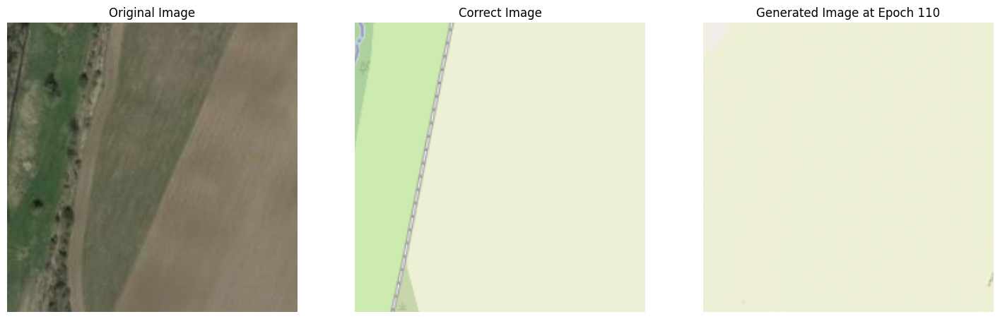

Epoch [110/1000], D Loss: 0.0658, G Loss: 13.3177
Epoch [111/1000], D Loss: 0.0658, G Loss: 13.1696
Epoch [112/1000], D Loss: 0.0694, G Loss: 13.0822
Epoch [113/1000], D Loss: 0.0706, G Loss: 13.0315
Epoch [114/1000], D Loss: 0.0643, G Loss: 12.9964


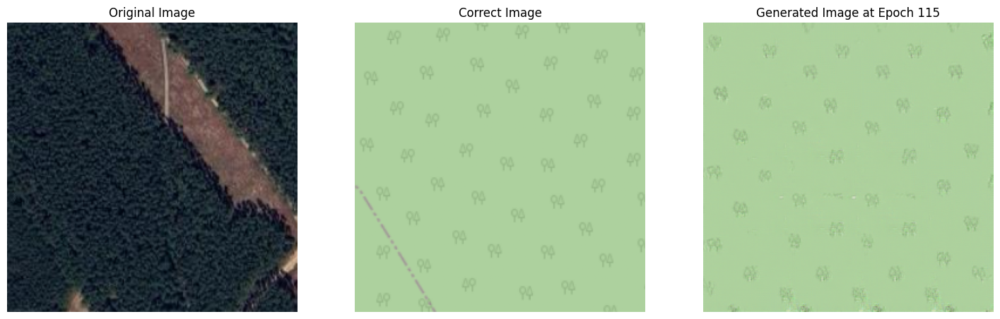

Epoch [115/1000], D Loss: 0.1015, G Loss: 13.2871
Epoch [116/1000], D Loss: 0.0983, G Loss: 12.3759
Epoch [117/1000], D Loss: 0.0521, G Loss: 12.7815
Epoch [118/1000], D Loss: 0.1008, G Loss: 13.1381
Epoch [119/1000], D Loss: 0.0870, G Loss: 13.1821


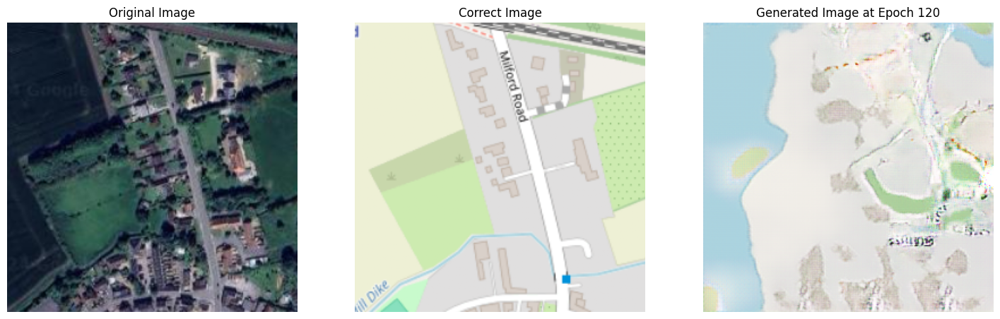

Epoch [120/1000], D Loss: 0.0488, G Loss: 13.3106
Epoch [121/1000], D Loss: 0.0572, G Loss: 13.1437
Epoch [122/1000], D Loss: 0.0580, G Loss: 13.5910
Epoch [123/1000], D Loss: 0.0592, G Loss: 13.3383
Epoch [124/1000], D Loss: 0.0705, G Loss: 13.5618


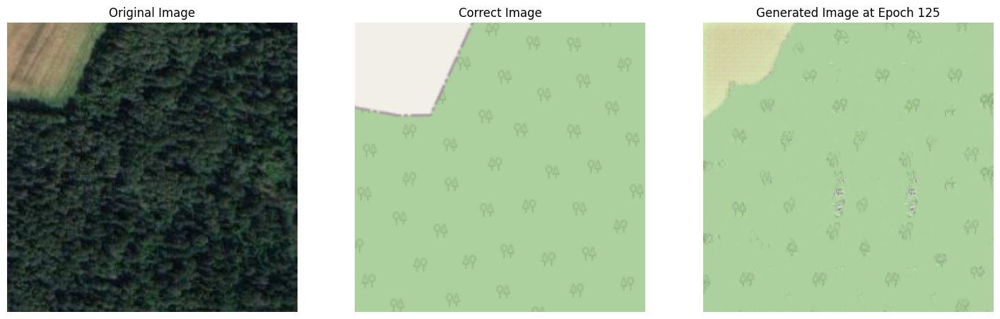

Epoch [125/1000], D Loss: 0.0543, G Loss: 14.1995
Epoch [126/1000], D Loss: 0.0629, G Loss: 15.1065
Epoch [127/1000], D Loss: 0.0650, G Loss: 14.9302
Epoch [128/1000], D Loss: 0.0612, G Loss: 14.4175
Epoch [129/1000], D Loss: 0.0808, G Loss: 13.2524


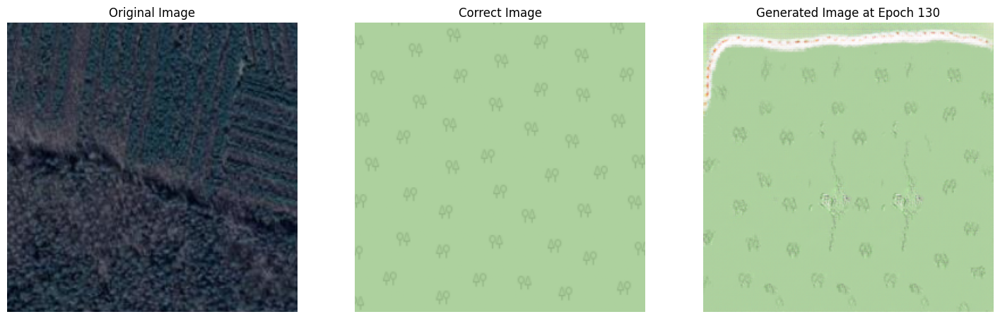

Epoch [130/1000], D Loss: 0.0675, G Loss: 14.4009
Epoch [131/1000], D Loss: 0.0928, G Loss: 14.9152
Epoch [132/1000], D Loss: 0.1883, G Loss: 14.4461
Epoch [133/1000], D Loss: 0.6322, G Loss: 11.6067
Epoch [134/1000], D Loss: 0.0880, G Loss: 12.7879


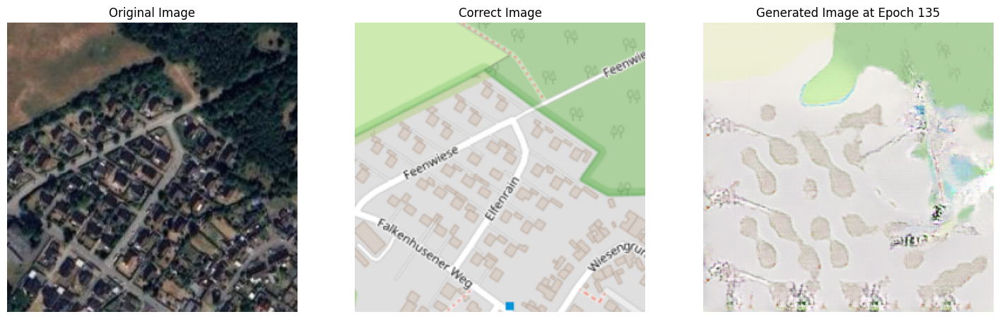

Epoch [135/1000], D Loss: 0.0840, G Loss: 12.6188
Epoch [136/1000], D Loss: 0.0557, G Loss: 14.0596
Epoch [137/1000], D Loss: 0.0669, G Loss: 13.8178
Epoch [138/1000], D Loss: 0.0610, G Loss: 13.3460
Epoch [139/1000], D Loss: 0.0651, G Loss: 13.5671


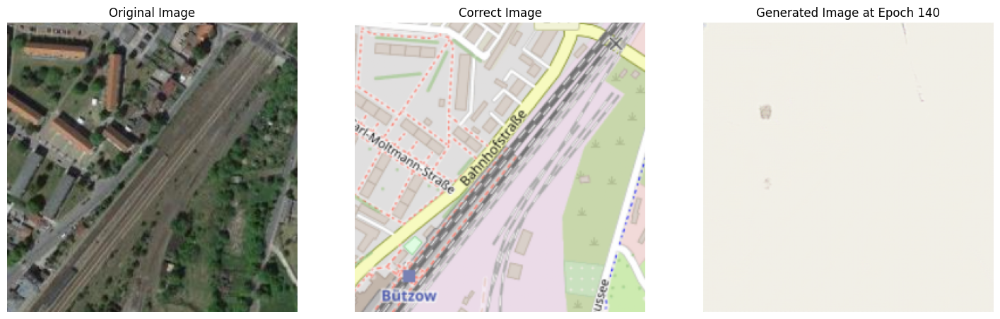

Epoch [140/1000], D Loss: 0.0740, G Loss: 13.2364
Epoch [141/1000], D Loss: 0.0595, G Loss: 13.8631
Epoch [142/1000], D Loss: 0.0789, G Loss: 14.1046
Epoch [143/1000], D Loss: 0.0574, G Loss: 15.1930
Epoch [144/1000], D Loss: 0.0599, G Loss: 13.6163


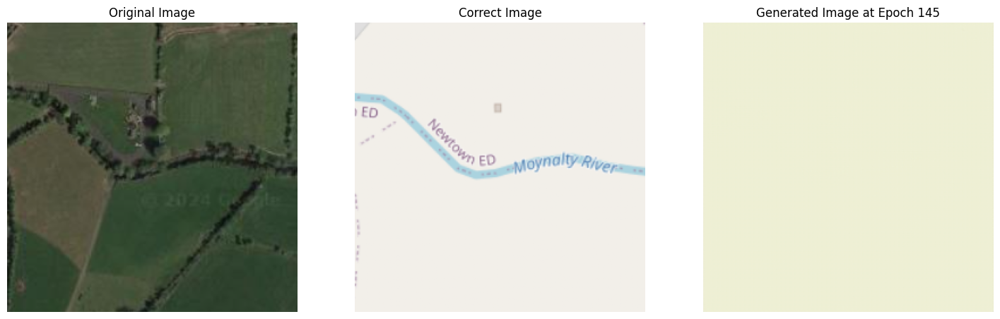

Epoch [145/1000], D Loss: 0.0876, G Loss: 13.4435
Epoch [146/1000], D Loss: 0.0760, G Loss: 14.6067
Epoch [147/1000], D Loss: 0.0509, G Loss: 13.6283
Epoch [148/1000], D Loss: 0.0545, G Loss: 14.0162
Epoch [149/1000], D Loss: 0.0933, G Loss: 14.6488


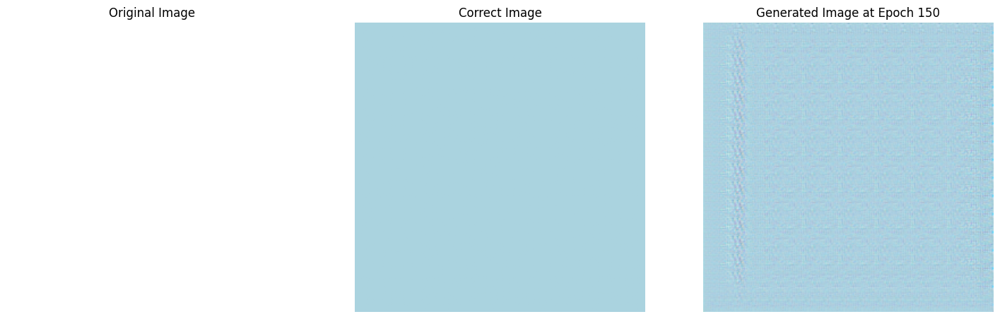

Epoch [150/1000], D Loss: 0.0524, G Loss: 14.4548
Epoch [151/1000], D Loss: 0.0690, G Loss: 14.8902
Epoch [152/1000], D Loss: 0.0585, G Loss: 14.6391
Epoch [153/1000], D Loss: 0.0504, G Loss: 15.9034
Epoch [154/1000], D Loss: 0.0736, G Loss: 16.1537


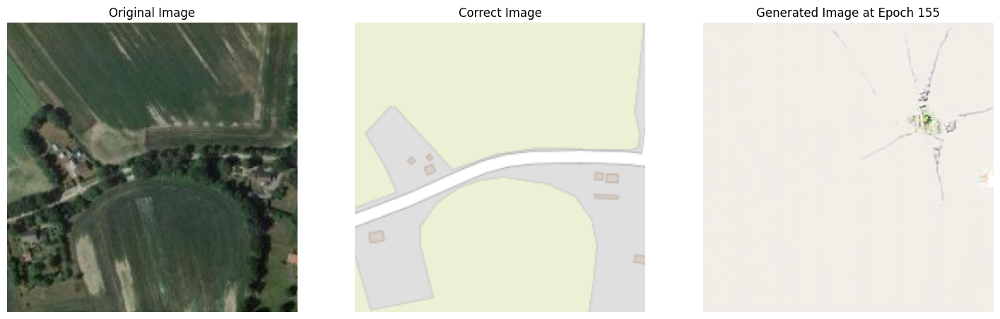

Epoch [155/1000], D Loss: 0.0480, G Loss: 17.2077
Epoch [156/1000], D Loss: 0.0632, G Loss: 18.2960
Epoch [157/1000], D Loss: 0.0469, G Loss: 18.8558
Epoch [158/1000], D Loss: 0.0554, G Loss: 15.4384
Epoch [159/1000], D Loss: 0.0534, G Loss: 15.3386


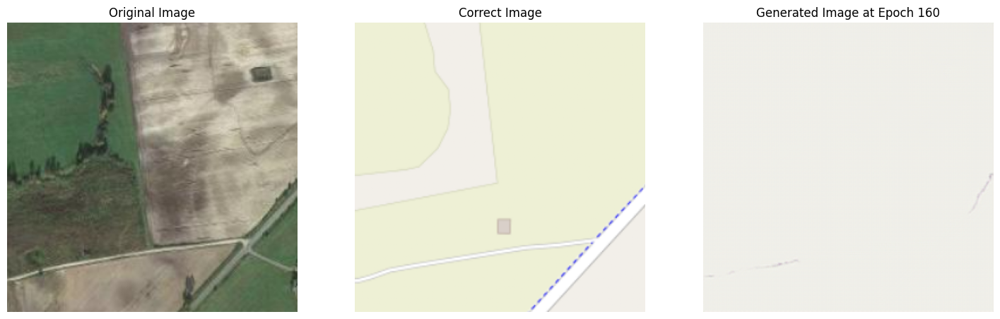

Epoch [160/1000], D Loss: 0.0720, G Loss: 15.7905
Epoch [161/1000], D Loss: 0.0965, G Loss: 15.1645
Epoch [162/1000], D Loss: 0.0590, G Loss: 15.0748
Epoch [163/1000], D Loss: 0.0662, G Loss: 14.5932
Epoch [164/1000], D Loss: 0.0500, G Loss: 14.3224


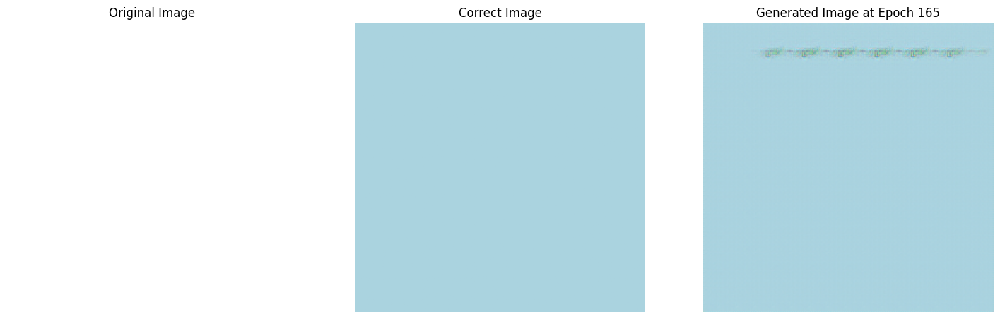

Epoch [165/1000], D Loss: 0.0839, G Loss: 16.2526
Epoch [166/1000], D Loss: 0.0518, G Loss: 13.9441
Epoch [167/1000], D Loss: 0.0758, G Loss: 14.0386
Epoch [168/1000], D Loss: 0.0736, G Loss: 13.6024
Epoch [169/1000], D Loss: 0.0539, G Loss: 13.7655


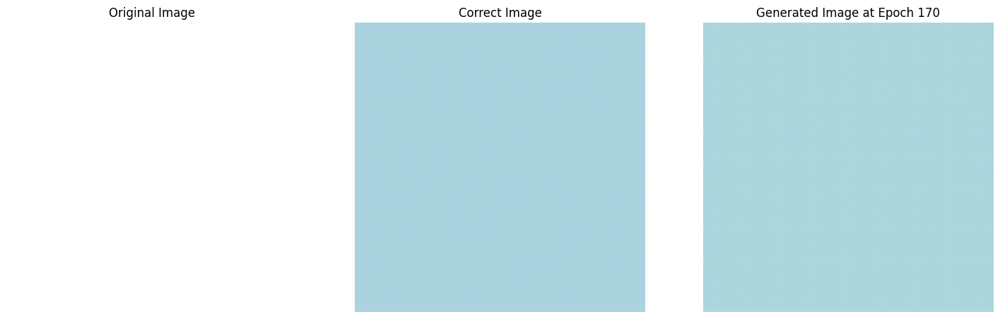

Epoch [170/1000], D Loss: 0.0420, G Loss: 15.7347
Epoch [171/1000], D Loss: 0.0750, G Loss: 15.3586
Epoch [172/1000], D Loss: 0.0456, G Loss: 14.3883
Epoch [173/1000], D Loss: 0.0666, G Loss: 14.7295
Epoch [174/1000], D Loss: 0.0498, G Loss: 14.5433


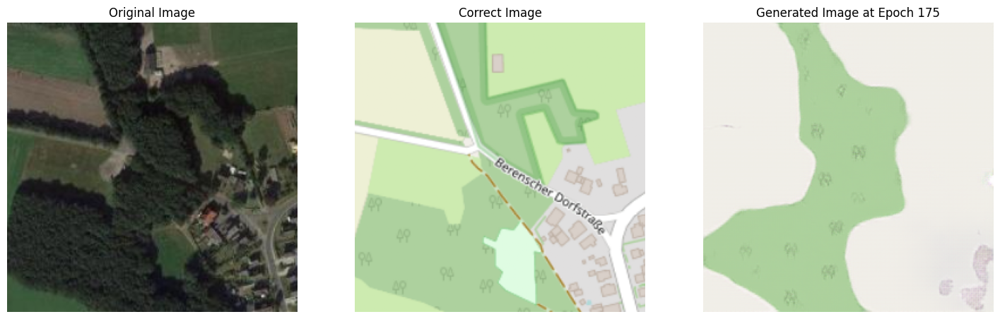

Epoch [175/1000], D Loss: 0.3681, G Loss: 12.8122
Epoch [176/1000], D Loss: 0.2669, G Loss: 11.2228
Epoch [177/1000], D Loss: 0.1447, G Loss: 12.0917
Epoch [178/1000], D Loss: 0.2199, G Loss: 12.8807
Epoch [179/1000], D Loss: 0.1433, G Loss: 12.1575


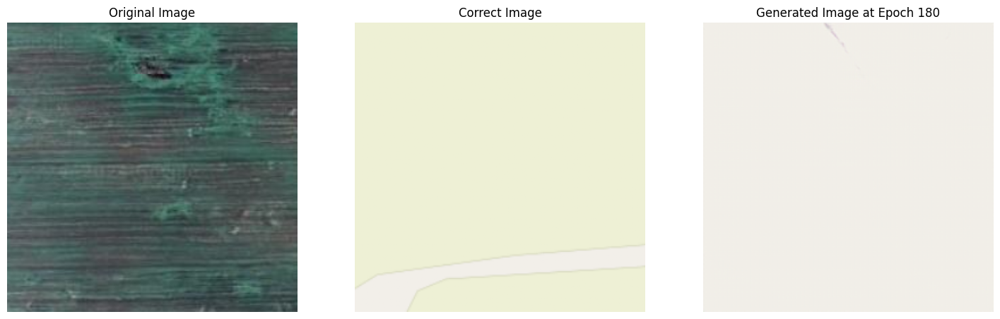

Epoch [180/1000], D Loss: 0.0688, G Loss: 13.1764
Epoch [181/1000], D Loss: 0.0776, G Loss: 12.6987
Epoch [182/1000], D Loss: 0.0577, G Loss: 13.7859
Epoch [183/1000], D Loss: 0.0655, G Loss: 12.4425
Epoch [184/1000], D Loss: 0.0737, G Loss: 12.7826


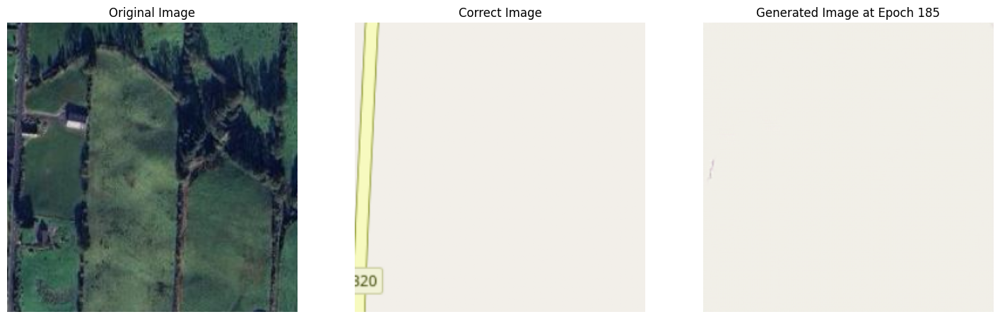

Epoch [185/1000], D Loss: 0.0487, G Loss: 15.1511
Epoch [186/1000], D Loss: 0.0510, G Loss: 13.7988
Epoch [187/1000], D Loss: 0.1296, G Loss: 13.1389
Epoch [188/1000], D Loss: 0.0483, G Loss: 14.1912
Epoch [189/1000], D Loss: 0.2664, G Loss: 12.8227


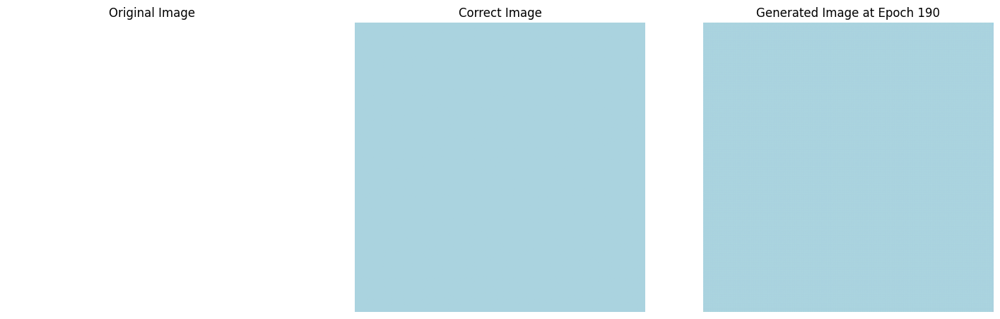

Epoch [190/1000], D Loss: 0.1038, G Loss: 13.0747
Epoch [191/1000], D Loss: 0.0632, G Loss: 13.9047
Epoch [192/1000], D Loss: 0.0690, G Loss: 12.9858
Epoch [193/1000], D Loss: 0.0825, G Loss: 12.8728
Epoch [194/1000], D Loss: 0.0575, G Loss: 13.3913


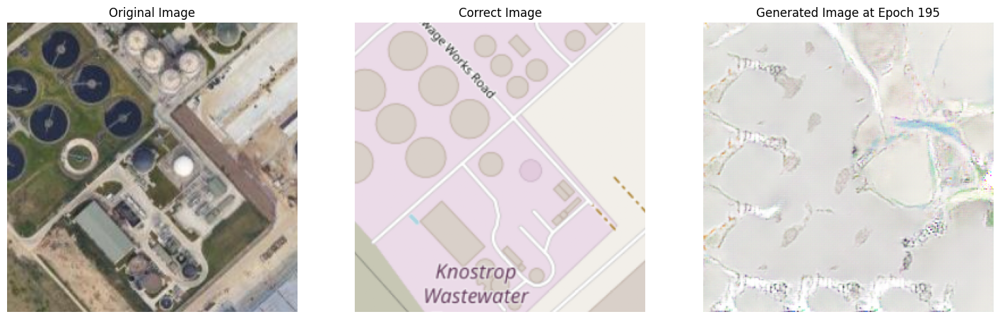

Epoch [195/1000], D Loss: 0.0758, G Loss: 13.2164
Epoch [196/1000], D Loss: 0.0545, G Loss: 13.5378
Epoch [197/1000], D Loss: 0.0522, G Loss: 14.2616
Epoch [198/1000], D Loss: 0.2300, G Loss: 13.0836
Epoch [199/1000], D Loss: 0.2585, G Loss: 11.3953


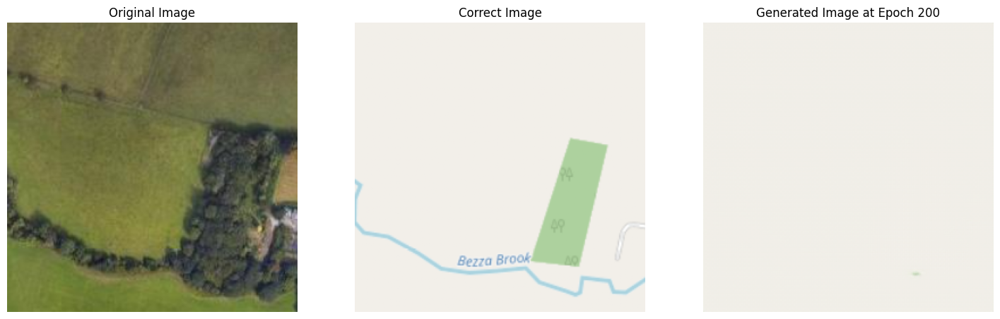

Epoch [200/1000], D Loss: 0.2926, G Loss: 11.0710
Epoch [201/1000], D Loss: 0.1011, G Loss: 12.4832
Epoch [202/1000], D Loss: 0.0619, G Loss: 13.3949
Epoch [203/1000], D Loss: 0.0661, G Loss: 13.5478
Epoch [204/1000], D Loss: 0.0619, G Loss: 13.4372


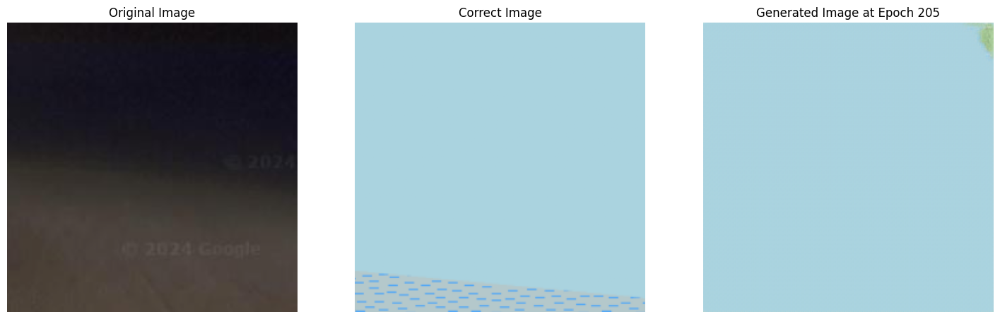

Epoch [205/1000], D Loss: 0.0586, G Loss: 13.1650
Epoch [206/1000], D Loss: 0.0603, G Loss: 13.7982
Epoch [207/1000], D Loss: 0.0606, G Loss: 13.7626
Epoch [208/1000], D Loss: 0.0430, G Loss: 14.3688
Epoch [209/1000], D Loss: 0.0589, G Loss: 14.1086


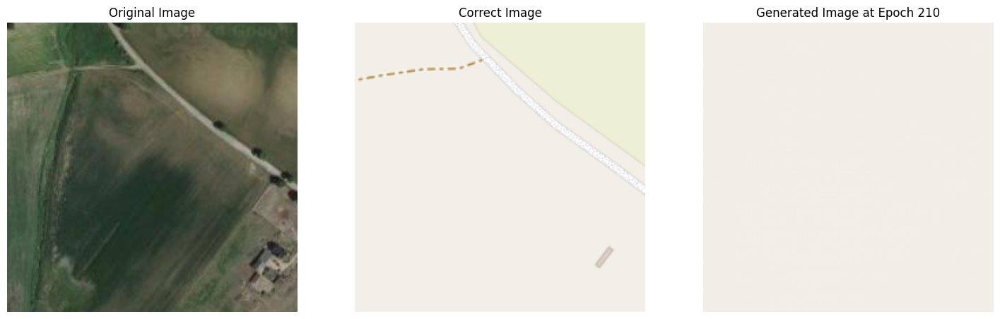

Epoch [210/1000], D Loss: 0.0500, G Loss: 15.9918
Epoch [211/1000], D Loss: 0.0549, G Loss: 14.6853
Epoch [212/1000], D Loss: 0.0592, G Loss: 14.6009
Epoch [213/1000], D Loss: 0.0609, G Loss: 13.6873
Epoch [214/1000], D Loss: 0.0442, G Loss: 13.9775


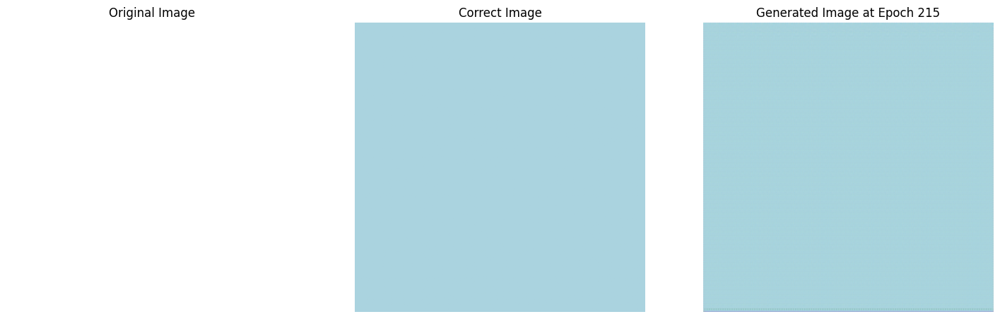

Epoch [215/1000], D Loss: 0.0697, G Loss: 14.7207
Epoch [216/1000], D Loss: 0.0405, G Loss: 15.2615
Epoch [217/1000], D Loss: 0.0582, G Loss: 14.2427
Epoch [218/1000], D Loss: 0.0551, G Loss: 15.1450
Epoch [219/1000], D Loss: 0.0519, G Loss: 13.2842


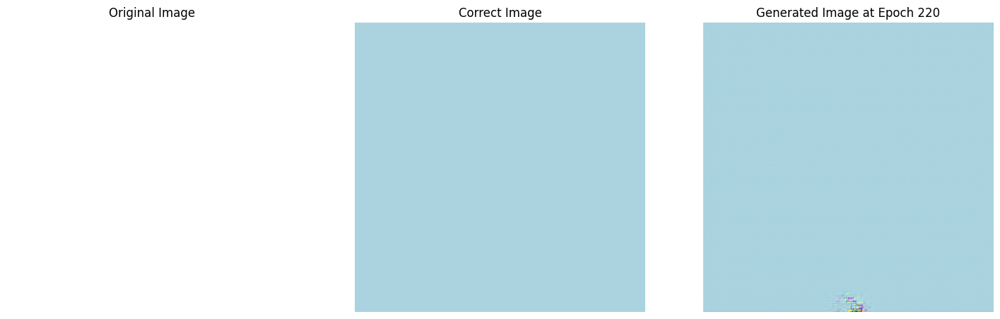

Epoch [220/1000], D Loss: 0.0693, G Loss: 12.9979
Epoch [221/1000], D Loss: 0.0570, G Loss: 12.6383
Epoch [222/1000], D Loss: 0.0595, G Loss: 12.9008
Epoch [223/1000], D Loss: 0.0721, G Loss: 13.0141
Epoch [224/1000], D Loss: 0.0795, G Loss: 13.2007


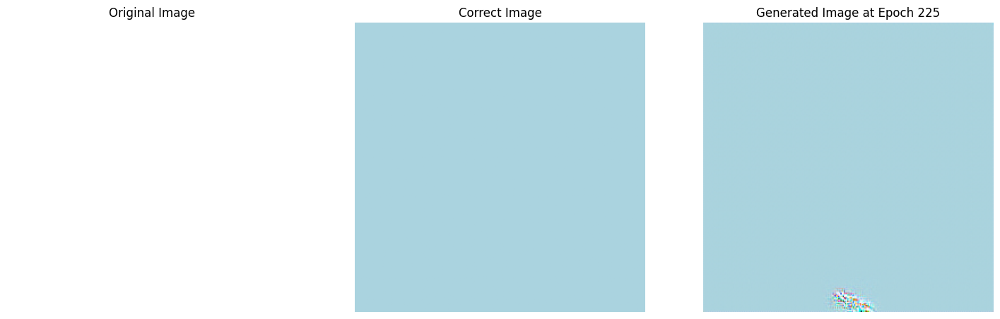

Epoch [225/1000], D Loss: 0.0576, G Loss: 13.4311
Epoch [226/1000], D Loss: 0.0480, G Loss: 13.7472
Epoch [227/1000], D Loss: 0.0526, G Loss: 14.0132
Epoch [228/1000], D Loss: 0.1475, G Loss: 13.7046
Epoch [229/1000], D Loss: 0.0722, G Loss: 13.0240


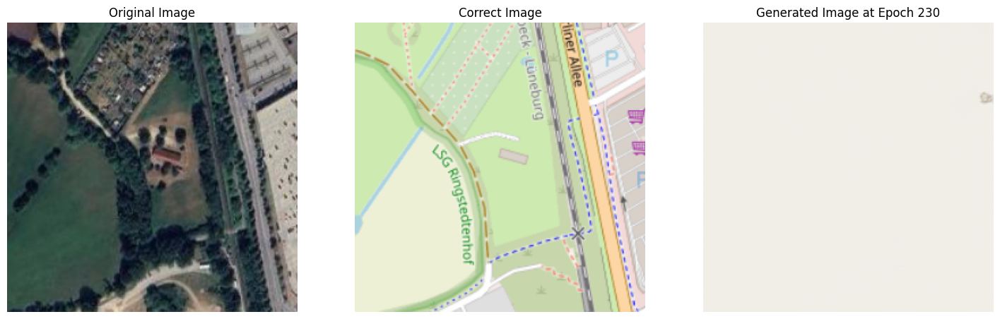

Epoch [230/1000], D Loss: 0.0808, G Loss: 13.2468
Epoch [231/1000], D Loss: 0.0857, G Loss: 13.7404
Epoch [232/1000], D Loss: 0.0727, G Loss: 13.7064
Epoch [233/1000], D Loss: 0.0628, G Loss: 15.2942
Epoch [234/1000], D Loss: 0.0635, G Loss: 14.9673


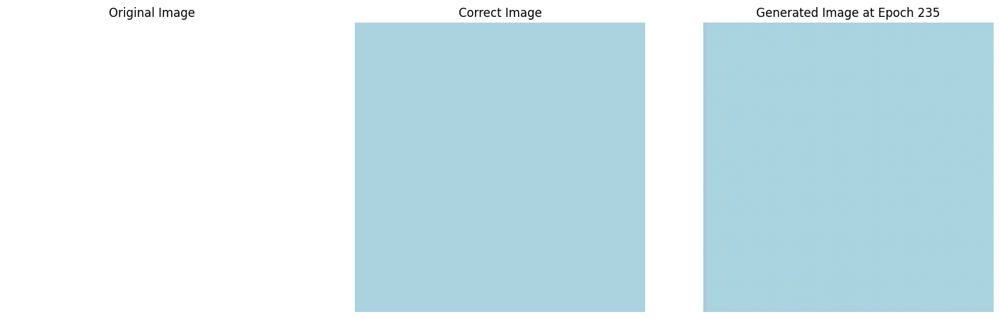

Epoch [235/1000], D Loss: 0.0396, G Loss: 14.0589
Epoch [236/1000], D Loss: 0.0460, G Loss: 14.7964
Epoch [237/1000], D Loss: 0.0538, G Loss: 16.3433
Epoch [238/1000], D Loss: 0.2684, G Loss: 13.8519
Epoch [239/1000], D Loss: 0.3300, G Loss: 11.6806


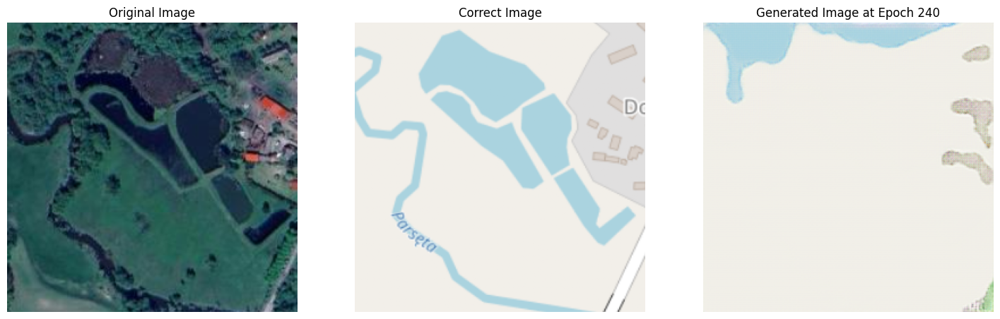

Epoch [240/1000], D Loss: 0.1716, G Loss: 12.2555
Epoch [241/1000], D Loss: 0.0677, G Loss: 12.9412
Epoch [242/1000], D Loss: 0.0557, G Loss: 13.5486
Epoch [243/1000], D Loss: 0.0549, G Loss: 14.5101
Epoch [244/1000], D Loss: 0.0446, G Loss: 13.7408


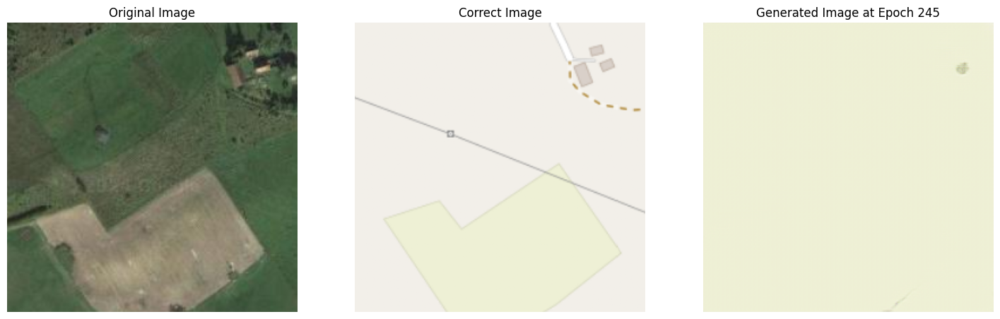

Epoch [245/1000], D Loss: 0.0613, G Loss: 14.1668
Epoch [246/1000], D Loss: 0.0661, G Loss: 13.1890
Epoch [247/1000], D Loss: 0.0545, G Loss: 13.6164
Epoch [248/1000], D Loss: 0.0551, G Loss: 13.4868
Epoch [249/1000], D Loss: 0.0742, G Loss: 13.3473


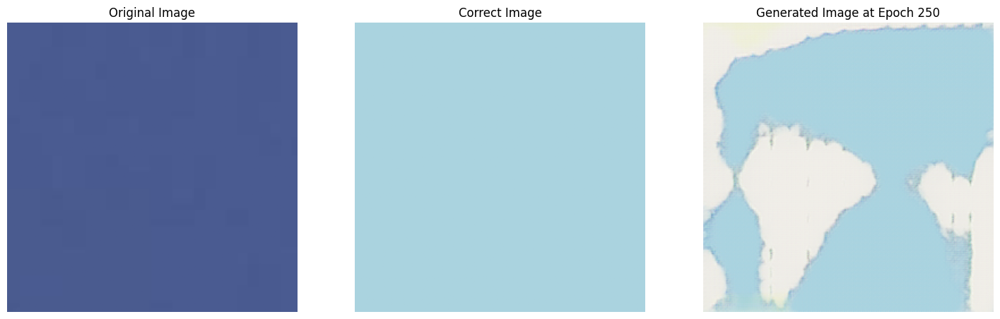

Epoch [250/1000], D Loss: 0.0462, G Loss: 15.4377
Epoch [251/1000], D Loss: 0.0465, G Loss: 16.8951
Epoch [252/1000], D Loss: 0.1384, G Loss: 16.9191
Epoch [253/1000], D Loss: 0.0616, G Loss: 15.0859
Epoch [254/1000], D Loss: 0.0489, G Loss: 14.6964


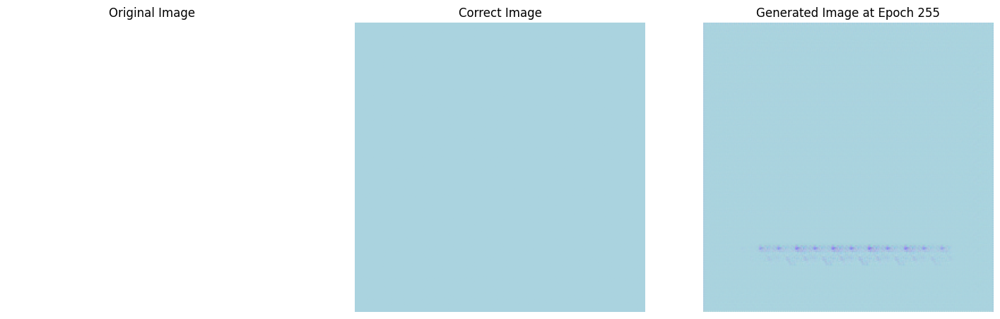

Epoch [255/1000], D Loss: 0.0598, G Loss: 15.4172
Epoch [256/1000], D Loss: 0.0537, G Loss: 13.6856
Epoch [257/1000], D Loss: 0.0632, G Loss: 13.5085
Epoch [258/1000], D Loss: 0.0798, G Loss: 13.9557
Epoch [259/1000], D Loss: 0.0812, G Loss: 13.2930


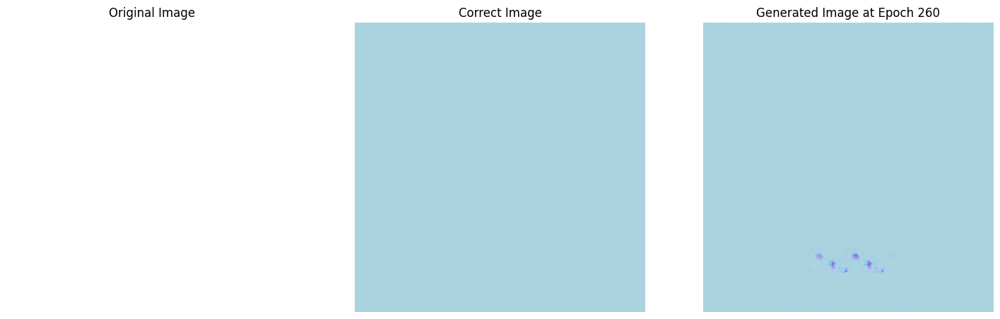

Epoch [260/1000], D Loss: 0.0684, G Loss: 12.4811
Epoch [261/1000], D Loss: 0.0598, G Loss: 13.6616
Epoch [262/1000], D Loss: 0.0681, G Loss: 13.6819
Epoch [263/1000], D Loss: 0.0834, G Loss: 13.4900
Epoch [264/1000], D Loss: 0.1964, G Loss: 12.5743


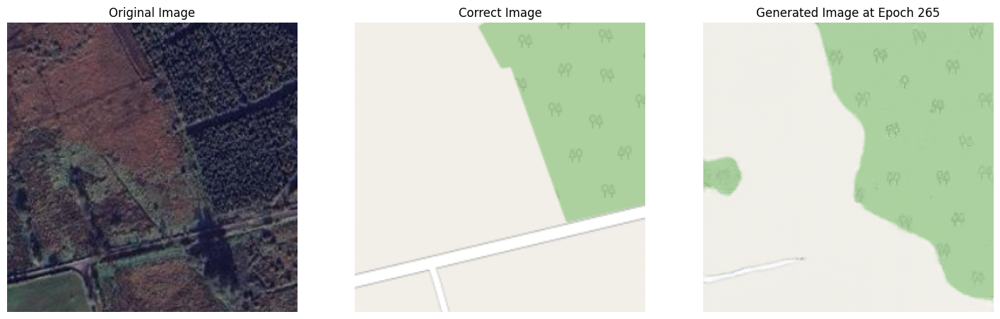

Epoch [265/1000], D Loss: 0.1029, G Loss: 13.0135
Epoch [266/1000], D Loss: 0.0587, G Loss: 13.1456
Epoch [267/1000], D Loss: 0.0533, G Loss: 14.1951
Epoch [268/1000], D Loss: 0.0798, G Loss: 15.1279
Epoch [269/1000], D Loss: 0.0608, G Loss: 13.9103


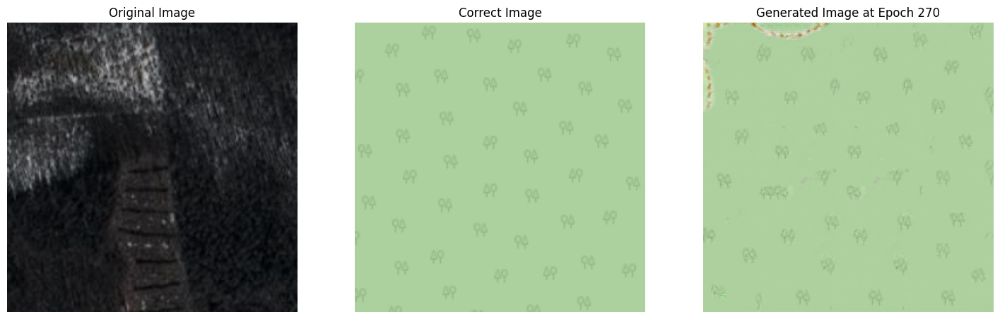

Epoch [270/1000], D Loss: 0.0748, G Loss: 14.3314
Epoch [271/1000], D Loss: 0.0423, G Loss: 14.4356
Epoch [272/1000], D Loss: 0.0471, G Loss: 13.6963
Epoch [273/1000], D Loss: 0.0515, G Loss: 13.6354
Epoch [274/1000], D Loss: 0.3590, G Loss: 12.8738


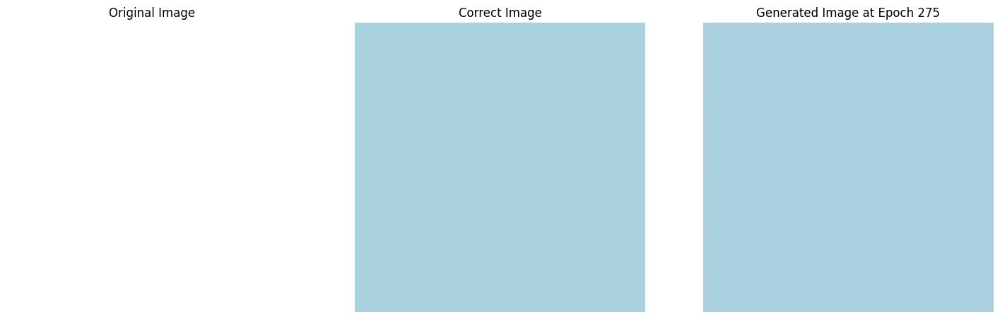

Epoch [275/1000], D Loss: 0.2222, G Loss: 11.1941
Epoch [276/1000], D Loss: 0.0732, G Loss: 13.7664
Epoch [277/1000], D Loss: 0.0657, G Loss: 13.3862
Epoch [278/1000], D Loss: 0.0963, G Loss: 13.0834
Epoch [279/1000], D Loss: 0.0435, G Loss: 14.5742


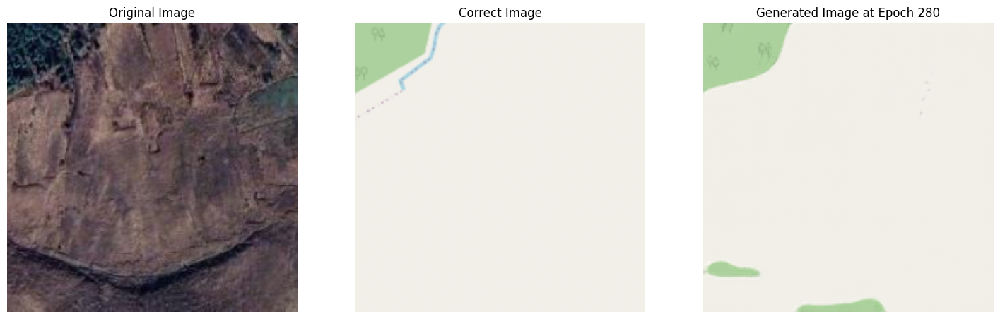

Epoch [280/1000], D Loss: 0.0502, G Loss: 14.3707
Epoch [281/1000], D Loss: 0.0607, G Loss: 13.7793
Epoch [282/1000], D Loss: 0.0687, G Loss: 14.8126
Epoch [283/1000], D Loss: 0.0708, G Loss: 13.4176
Epoch [284/1000], D Loss: 0.0801, G Loss: 13.5404


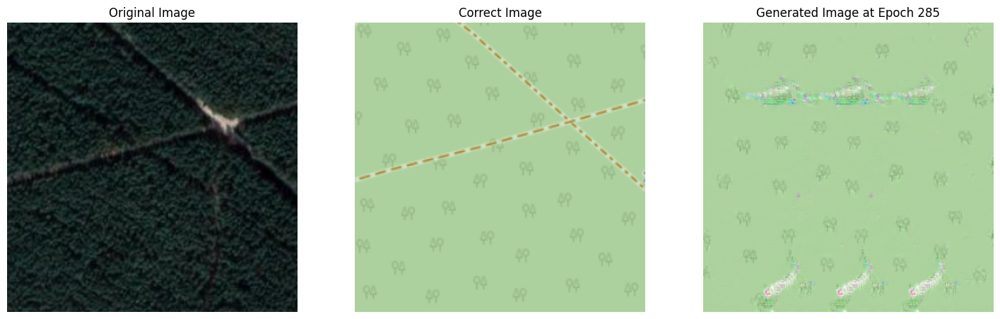

Epoch [285/1000], D Loss: 0.0770, G Loss: 13.2324
Epoch [286/1000], D Loss: 0.0637, G Loss: 14.5477
Epoch [287/1000], D Loss: 0.2252, G Loss: 12.3087
Epoch [288/1000], D Loss: 0.3250, G Loss: 12.1523
Epoch [289/1000], D Loss: 0.2379, G Loss: 11.4679


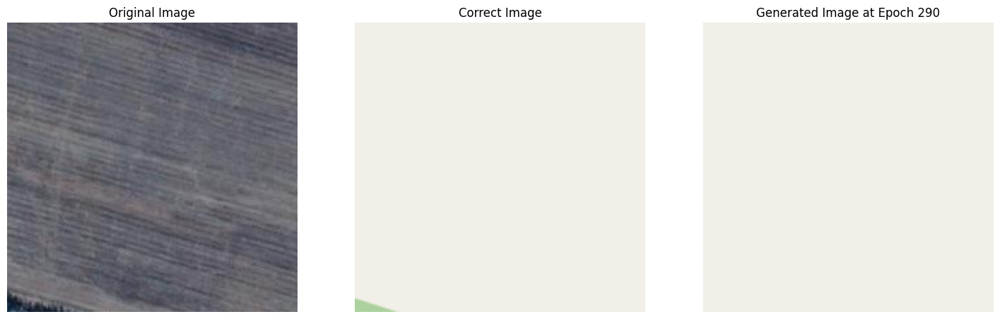

Epoch [290/1000], D Loss: 0.1913, G Loss: 11.3609
Epoch [291/1000], D Loss: 0.0905, G Loss: 12.4142
Epoch [292/1000], D Loss: 0.0757, G Loss: 12.9966
Epoch [293/1000], D Loss: 0.0664, G Loss: 13.0869
Epoch [294/1000], D Loss: 0.0596, G Loss: 12.6014


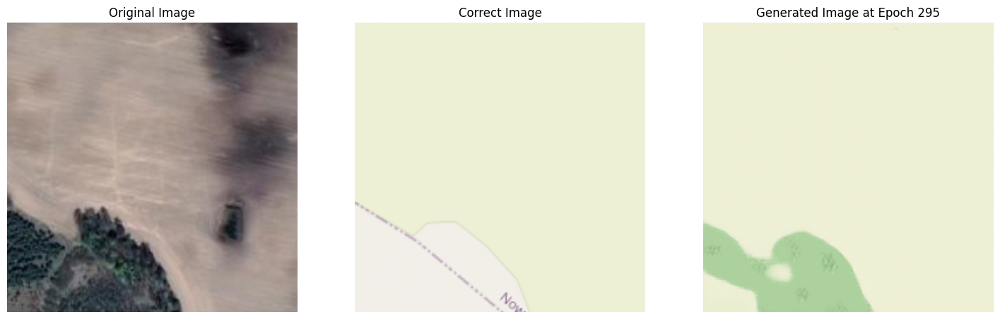

Epoch [295/1000], D Loss: 0.0702, G Loss: 12.4711
Epoch [296/1000], D Loss: 0.1010, G Loss: 12.7970
Epoch [297/1000], D Loss: 0.0812, G Loss: 12.0918
Epoch [298/1000], D Loss: 0.0531, G Loss: 12.7316
Epoch [299/1000], D Loss: 0.0852, G Loss: 12.3768


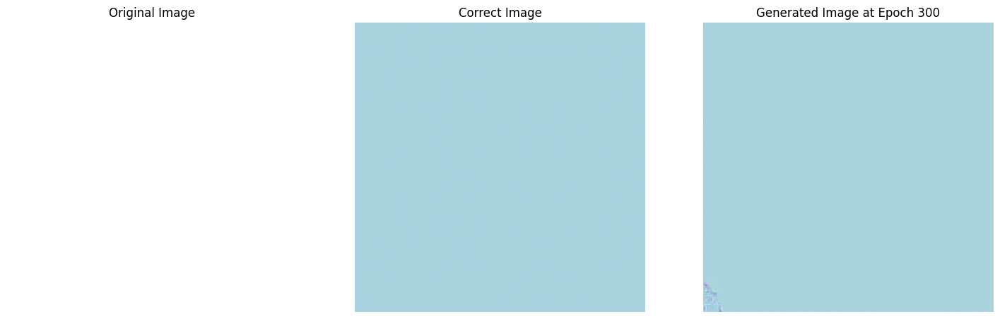

Epoch [300/1000], D Loss: 0.0618, G Loss: 12.4121
Epoch [301/1000], D Loss: 0.0736, G Loss: 12.2898
Epoch [302/1000], D Loss: 0.0656, G Loss: 13.0188
Epoch [303/1000], D Loss: 0.0647, G Loss: 12.9960
Epoch [304/1000], D Loss: 0.0535, G Loss: 15.2683


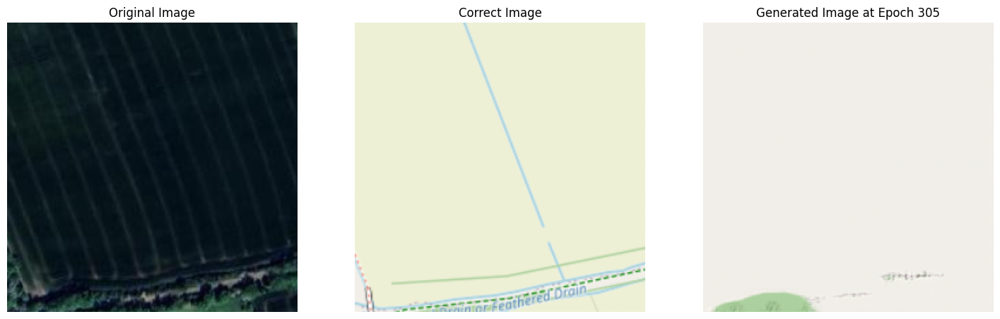

Epoch [305/1000], D Loss: 0.0452, G Loss: 15.1295
Epoch [306/1000], D Loss: 0.0515, G Loss: 13.6759
Epoch [307/1000], D Loss: 0.0691, G Loss: 13.9356
Epoch [308/1000], D Loss: 0.0538, G Loss: 15.1177
Epoch [309/1000], D Loss: 0.0372, G Loss: 16.7046


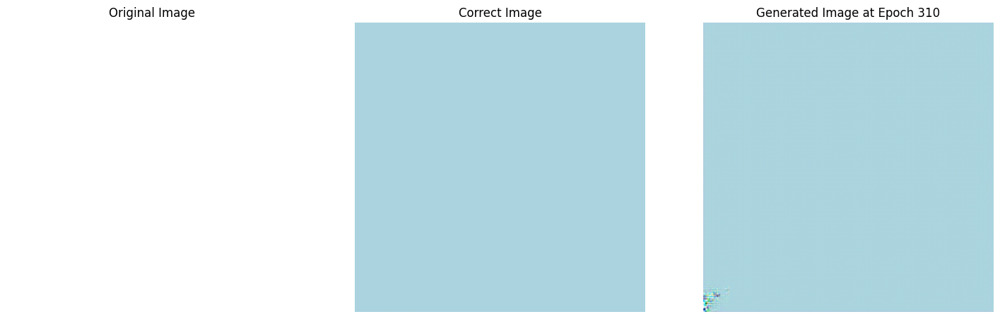

Epoch [310/1000], D Loss: 0.0667, G Loss: 13.2481
Epoch [311/1000], D Loss: 0.0556, G Loss: 13.9148
Epoch [312/1000], D Loss: 0.0849, G Loss: 13.0804
Epoch [313/1000], D Loss: 0.0673, G Loss: 13.4643
Epoch [314/1000], D Loss: 0.0747, G Loss: 13.9042


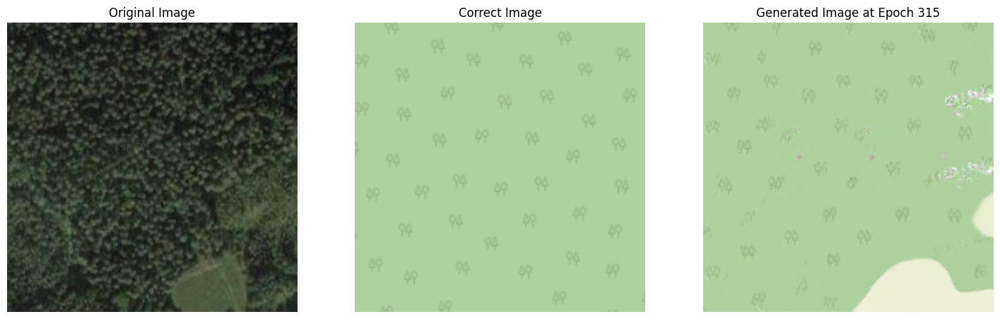

Epoch [315/1000], D Loss: 0.0902, G Loss: 12.6202
Epoch [316/1000], D Loss: 0.0889, G Loss: 13.1763
Epoch [317/1000], D Loss: 0.0742, G Loss: 13.0563
Epoch [318/1000], D Loss: 0.0568, G Loss: 13.4672
Epoch [319/1000], D Loss: 0.0686, G Loss: 12.9791


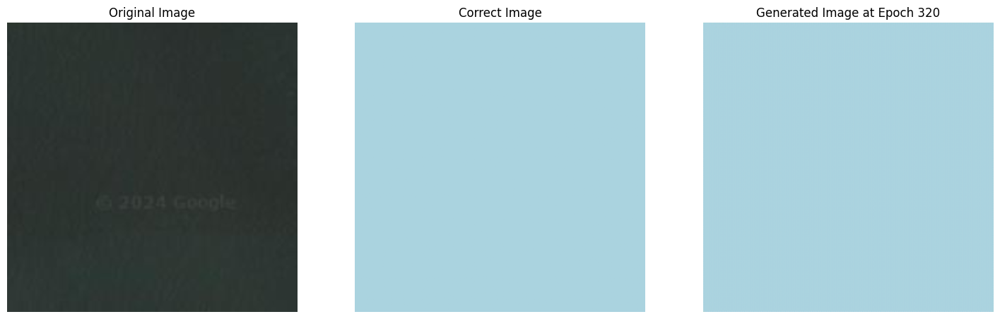

Epoch [320/1000], D Loss: 0.0523, G Loss: 13.3023
Epoch [321/1000], D Loss: 0.1003, G Loss: 12.9040
Epoch [322/1000], D Loss: 0.0511, G Loss: 14.2456
Epoch [323/1000], D Loss: 0.0555, G Loss: 14.1107
Epoch [324/1000], D Loss: 0.0554, G Loss: 13.1500


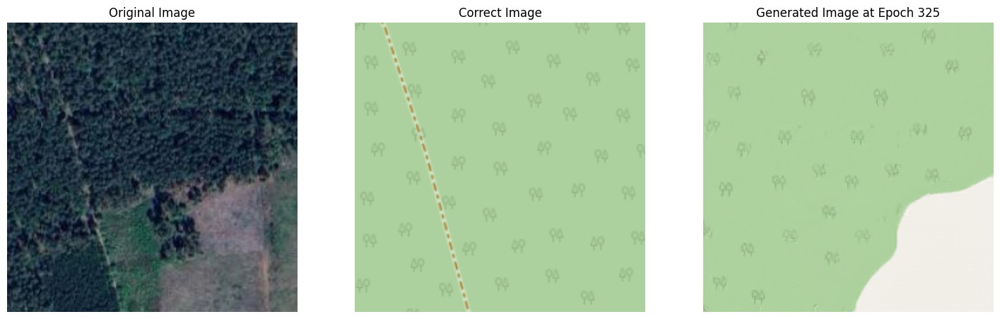

Epoch [325/1000], D Loss: 0.1788, G Loss: 13.0982
Epoch [326/1000], D Loss: 0.0589, G Loss: 13.2042
Epoch [327/1000], D Loss: 0.0675, G Loss: 13.3589
Epoch [328/1000], D Loss: 0.1036, G Loss: 12.5737
Epoch [329/1000], D Loss: 0.0583, G Loss: 13.0072


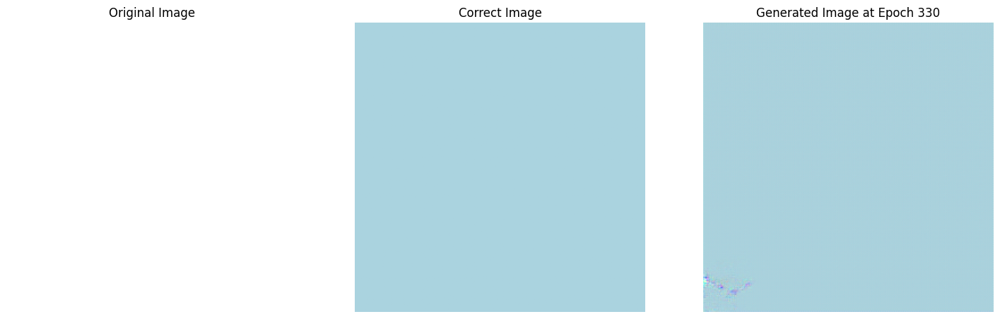

Epoch [330/1000], D Loss: 0.0705, G Loss: 12.9096
Epoch [331/1000], D Loss: 0.0745, G Loss: 13.7779
Epoch [332/1000], D Loss: 0.0624, G Loss: 14.2780
Epoch [333/1000], D Loss: 0.0419, G Loss: 16.0577
Epoch [334/1000], D Loss: 0.0299, G Loss: 16.0365


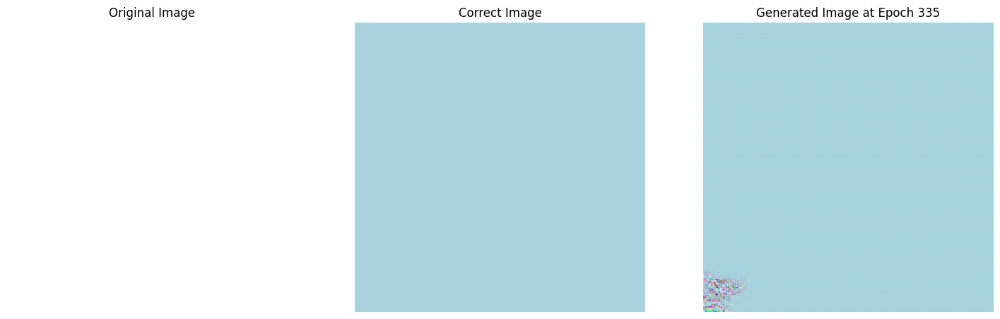

Epoch [335/1000], D Loss: 0.0428, G Loss: 16.0668
Epoch [336/1000], D Loss: 0.0370, G Loss: 14.2904
Epoch [337/1000], D Loss: 0.0506, G Loss: 13.9453
Epoch [338/1000], D Loss: 0.0836, G Loss: 13.8648
Epoch [339/1000], D Loss: 0.0489, G Loss: 14.4123


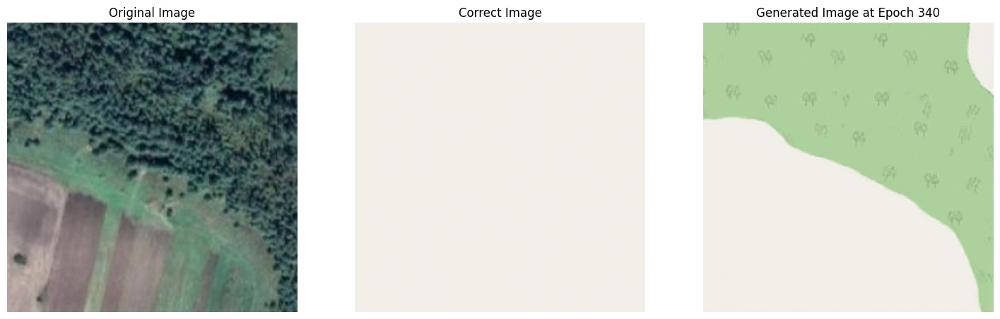

Epoch [340/1000], D Loss: 0.0698, G Loss: 13.6672
Epoch [341/1000], D Loss: 0.0358, G Loss: 15.0101
Epoch [342/1000], D Loss: 0.0676, G Loss: 14.4523
Epoch [343/1000], D Loss: 0.0891, G Loss: 13.5945
Epoch [344/1000], D Loss: 0.0652, G Loss: 16.1947


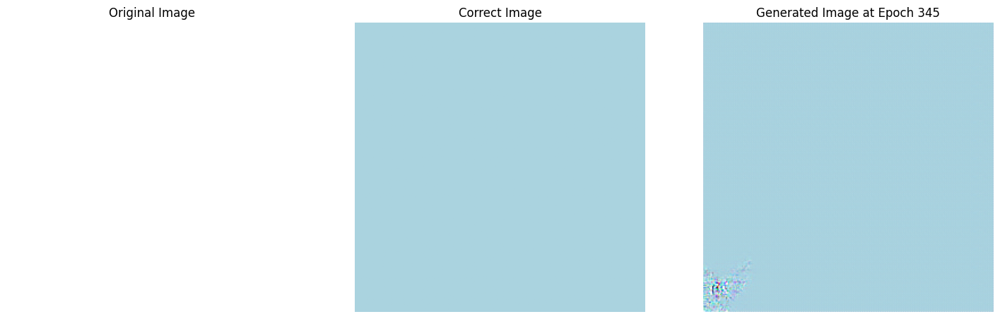

Epoch [345/1000], D Loss: 0.0296, G Loss: 16.7738
Epoch [346/1000], D Loss: 0.0609, G Loss: 16.9850
Epoch [347/1000], D Loss: 0.0256, G Loss: 16.4040
Epoch [348/1000], D Loss: 0.0462, G Loss: 16.0874
Epoch [349/1000], D Loss: 0.0790, G Loss: 15.5042


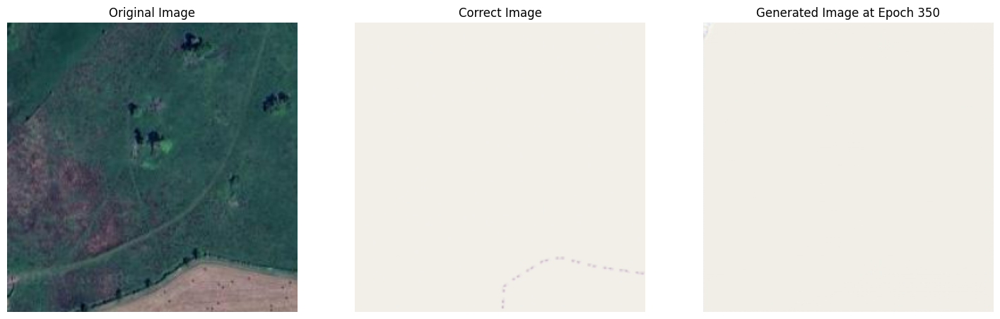

Epoch [350/1000], D Loss: 0.0480, G Loss: 15.4736
Epoch [351/1000], D Loss: 0.1981, G Loss: 15.2285
Epoch [352/1000], D Loss: 0.0736, G Loss: 15.5655
Epoch [353/1000], D Loss: 0.0637, G Loss: 14.5612
Epoch [354/1000], D Loss: 0.0599, G Loss: 15.4350


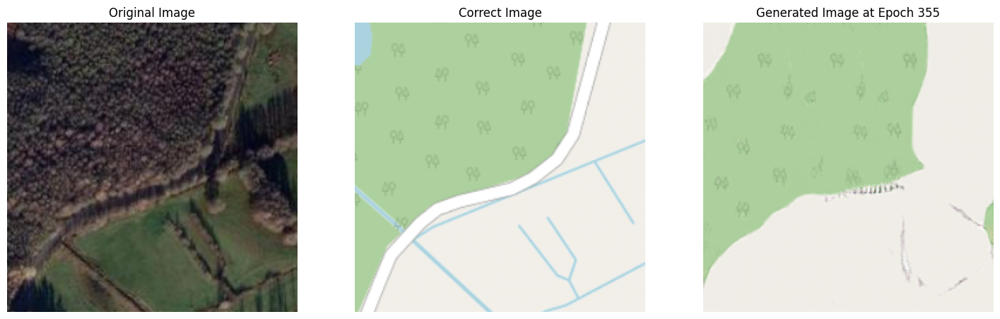

Epoch [355/1000], D Loss: 0.0434, G Loss: 15.2566
Epoch [356/1000], D Loss: 0.0450, G Loss: 14.7789
Epoch [357/1000], D Loss: 0.0573, G Loss: 15.8270
Epoch [358/1000], D Loss: 0.0476, G Loss: 16.2376
Epoch [359/1000], D Loss: 0.0548, G Loss: 14.6845


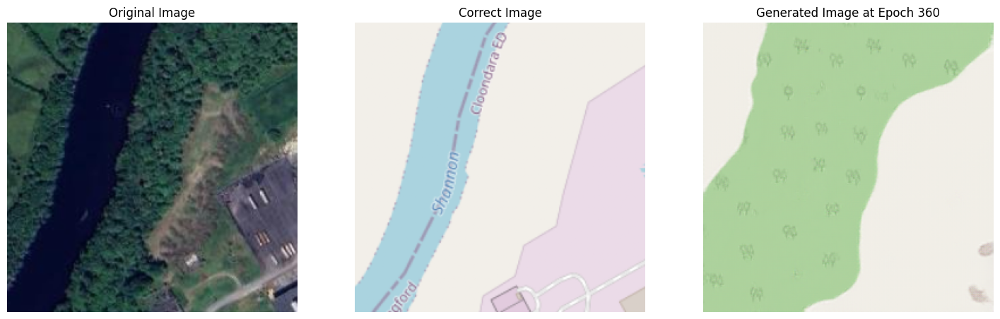

Epoch [360/1000], D Loss: 0.0738, G Loss: 14.7041
Epoch [361/1000], D Loss: 0.0825, G Loss: 15.0531
Epoch [362/1000], D Loss: 0.0965, G Loss: 14.4959
Epoch [363/1000], D Loss: 0.0648, G Loss: 15.1559
Epoch [364/1000], D Loss: 0.0471, G Loss: 14.8963


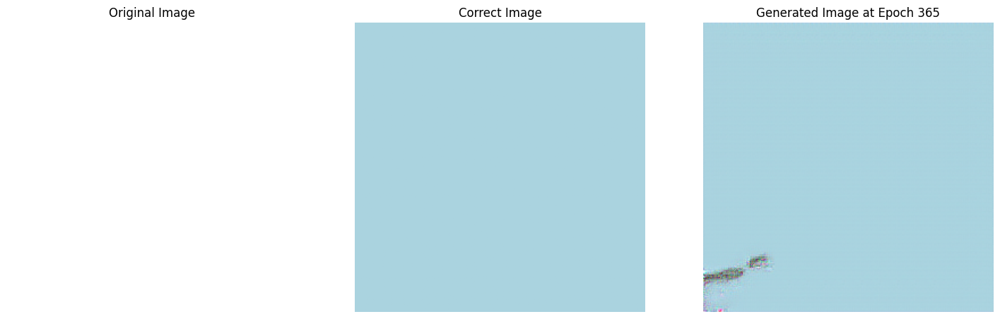

Epoch [365/1000], D Loss: 0.0646, G Loss: 14.7157
Epoch [366/1000], D Loss: 0.0652, G Loss: 15.5668
Epoch [367/1000], D Loss: 0.1023, G Loss: 15.3635
Epoch [368/1000], D Loss: 0.0819, G Loss: 14.6548
Epoch [369/1000], D Loss: 0.0589, G Loss: 14.9462


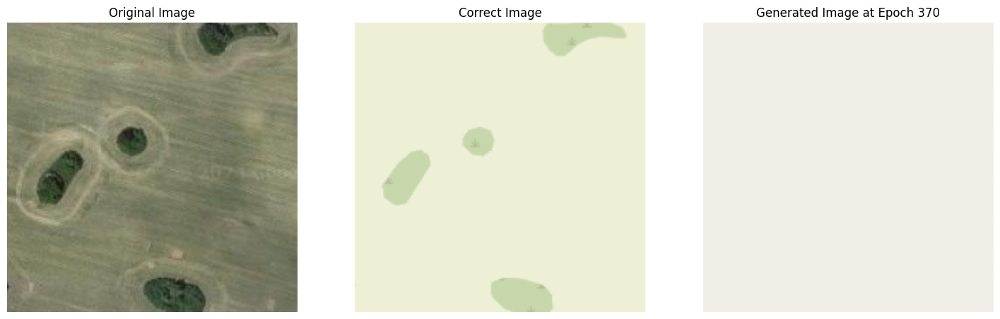

Epoch [370/1000], D Loss: 0.0497, G Loss: 14.5591
Epoch [371/1000], D Loss: 0.2438, G Loss: 14.7964
Epoch [372/1000], D Loss: 0.0736, G Loss: 14.2373
Epoch [373/1000], D Loss: 0.2028, G Loss: 13.5914
Epoch [374/1000], D Loss: 0.0514, G Loss: 14.0427


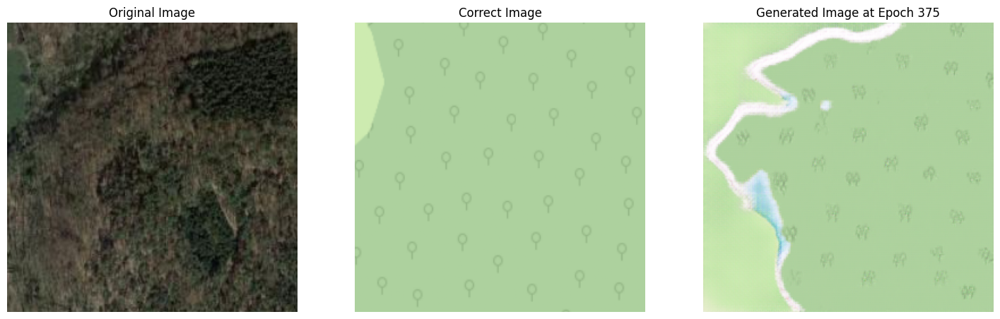

Epoch [375/1000], D Loss: 0.0552, G Loss: 14.0293
Epoch [376/1000], D Loss: 0.0417, G Loss: 15.6529
Epoch [377/1000], D Loss: 0.0469, G Loss: 14.6138
Epoch [378/1000], D Loss: 0.0490, G Loss: 14.3255
Epoch [379/1000], D Loss: 0.0607, G Loss: 14.0312


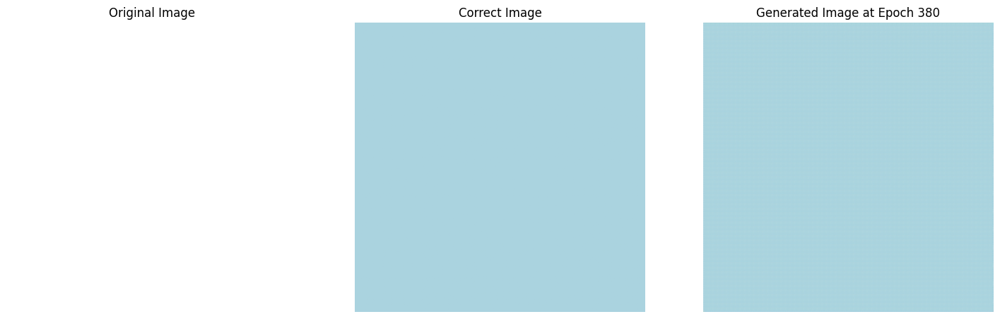

Epoch [380/1000], D Loss: 0.0605, G Loss: 14.6014
Epoch [381/1000], D Loss: 0.0757, G Loss: 14.6604
Epoch [382/1000], D Loss: 0.0499, G Loss: 15.1235
Epoch [383/1000], D Loss: 0.0628, G Loss: 14.9404
Epoch [384/1000], D Loss: 0.0643, G Loss: 14.0932


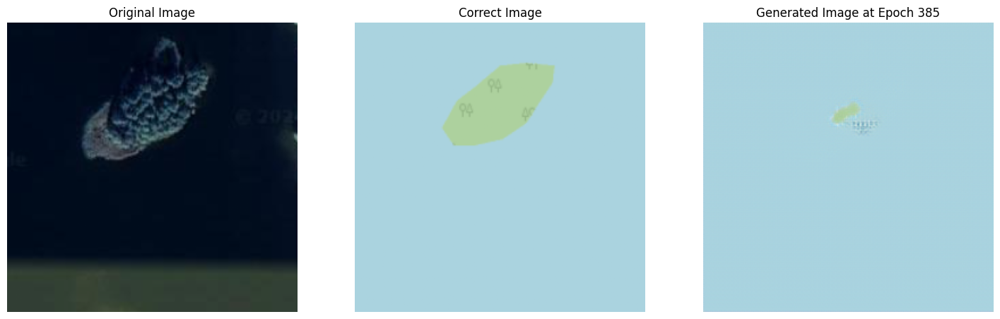

Epoch [385/1000], D Loss: 0.0549, G Loss: 14.0468
Epoch [386/1000], D Loss: 0.0741, G Loss: 13.7007
Epoch [387/1000], D Loss: 0.0570, G Loss: 14.0930
Epoch [388/1000], D Loss: 0.0569, G Loss: 15.2500
Epoch [389/1000], D Loss: 0.0401, G Loss: 14.2575


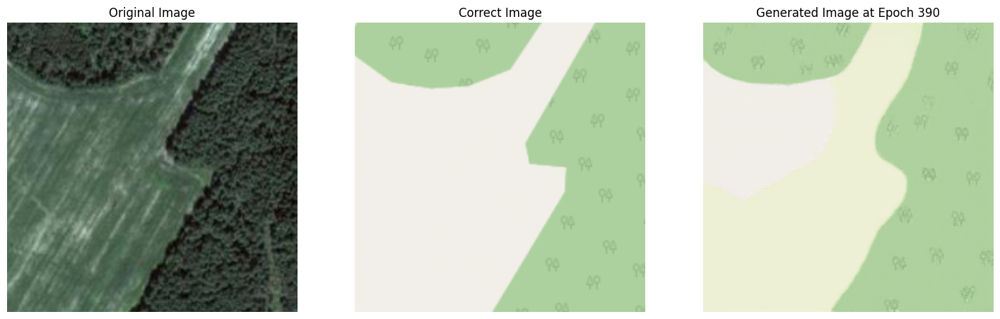

Epoch [390/1000], D Loss: 0.0427, G Loss: 15.0024
Epoch [391/1000], D Loss: 0.0784, G Loss: 16.4662
Epoch [392/1000], D Loss: 0.0582, G Loss: 15.6689
Epoch [393/1000], D Loss: 0.0576, G Loss: 14.5326
Epoch [394/1000], D Loss: 0.0591, G Loss: 14.3636


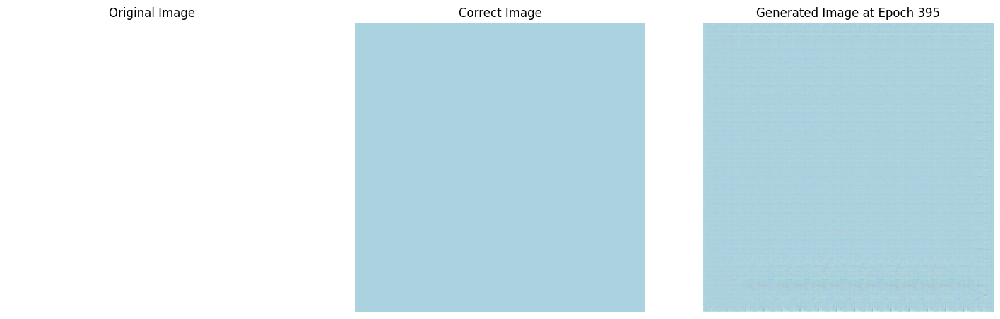

Epoch [395/1000], D Loss: 0.0576, G Loss: 14.0147
Epoch [396/1000], D Loss: 0.0569, G Loss: 14.4773
Epoch [397/1000], D Loss: 0.0419, G Loss: 14.8439
Epoch [398/1000], D Loss: 0.0558, G Loss: 14.7032
Epoch [399/1000], D Loss: 0.0681, G Loss: 16.4500


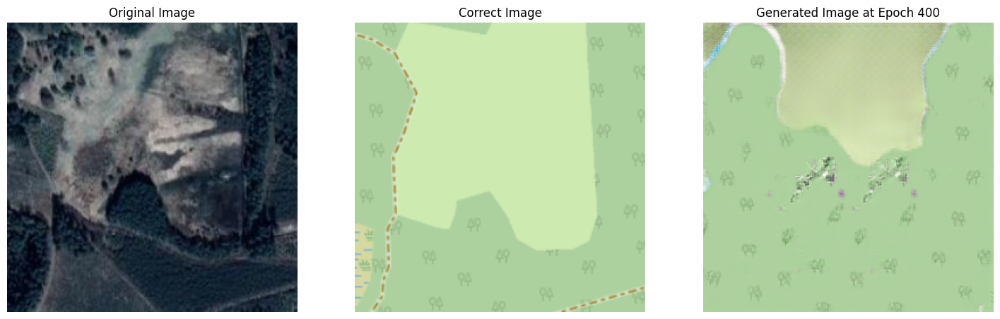

Epoch [400/1000], D Loss: 0.0412, G Loss: 15.3448
Epoch [401/1000], D Loss: 0.0637, G Loss: 15.2624
Epoch [402/1000], D Loss: 0.0679, G Loss: 15.5030
Epoch [403/1000], D Loss: 0.0605, G Loss: 17.7424
Epoch [404/1000], D Loss: 0.0530, G Loss: 20.4718


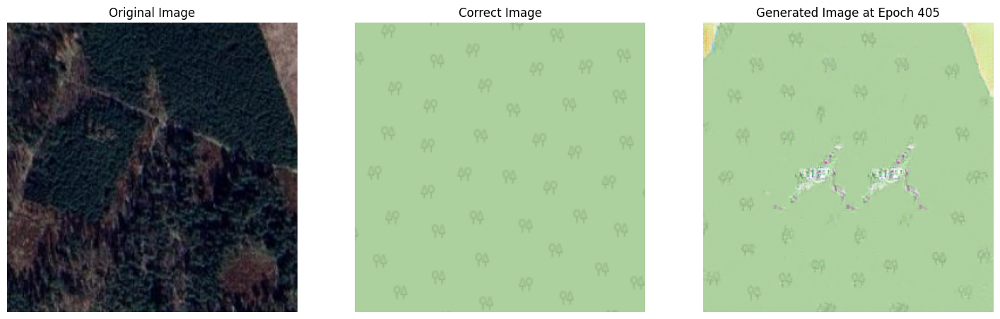

Epoch [405/1000], D Loss: 0.0532, G Loss: 18.1950
Epoch [406/1000], D Loss: 0.0786, G Loss: 19.7359
Epoch [407/1000], D Loss: 0.0890, G Loss: 18.9540
Epoch [408/1000], D Loss: 0.0903, G Loss: 18.5519
Epoch [409/1000], D Loss: 0.4898, G Loss: 20.5098


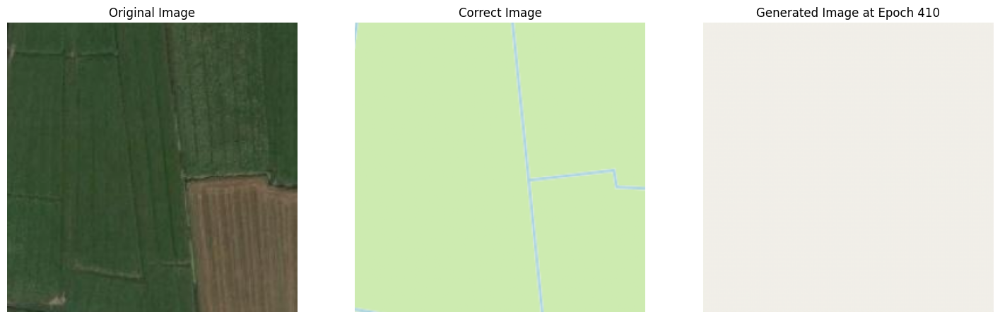

Epoch [410/1000], D Loss: 0.1072, G Loss: 17.9221
Epoch [411/1000], D Loss: 0.0732, G Loss: 16.9392
Epoch [412/1000], D Loss: 0.0620, G Loss: 14.8339
Epoch [413/1000], D Loss: 0.0525, G Loss: 15.6430
Epoch [414/1000], D Loss: 0.0426, G Loss: 16.1509


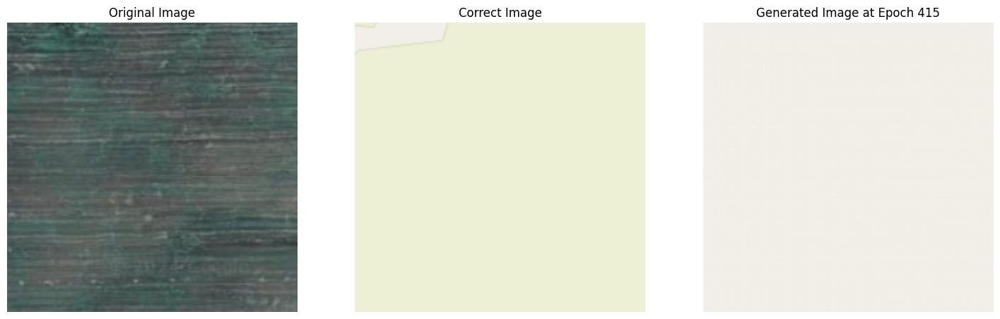

Epoch [415/1000], D Loss: 0.0935, G Loss: 13.5979
Epoch [416/1000], D Loss: 0.0762, G Loss: 14.0300
Epoch [417/1000], D Loss: 0.0739, G Loss: 14.9818
Epoch [418/1000], D Loss: 0.0526, G Loss: 13.2603
Epoch [419/1000], D Loss: 0.0414, G Loss: 15.2805


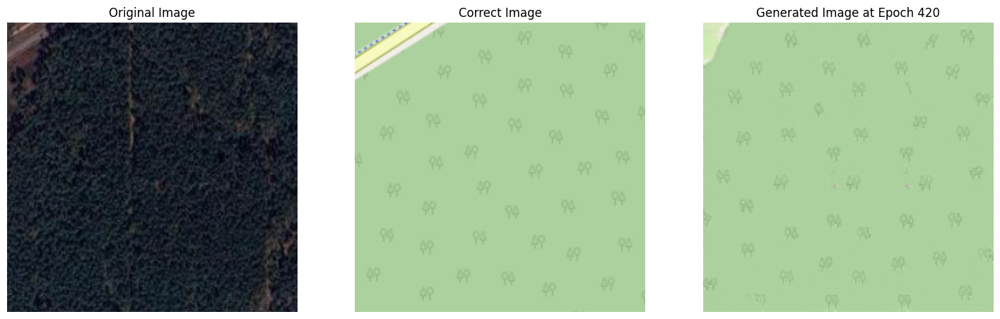

Epoch [420/1000], D Loss: 0.0495, G Loss: 14.9802
Epoch [421/1000], D Loss: 0.2075, G Loss: 15.0462
Epoch [422/1000], D Loss: 0.0602, G Loss: 13.2832
Epoch [423/1000], D Loss: 0.0502, G Loss: 13.6009
Epoch [424/1000], D Loss: 0.0792, G Loss: 12.9369


In [ ]:
for epoch in range(epochs):
    generator.train()
    discriminator.train()

    running_loss_g = 0.0
    running_loss_d = 0.0

    for in_image, out_image in dataloader:
        x, real = in_image.to(device), out_image.to(device)

        x = x.to(device)
        real = real.to(device)

        fake = generator(x)
        fake_pred = discriminator(fake, x)
        g_loss = g_criterion(fake, real, fake_pred)

        # Discriminator`s loss
        fake = generator(x).detach()
        fake_pred = discriminator(fake, x)
        real_pred = discriminator(real, x)
        d_loss = d_criterion(fake_pred, real_pred)

        # Generator`s params update
        g_optimizer.zero_grad()
        g_loss.backward()
        g_optimizer.step()

        # Discriminator`s params update
        d_optimizer.zero_grad()
        d_loss.backward()
        d_optimizer.step()
        # add batch losses
        running_loss_g += g_loss.item()
        running_loss_d += d_loss.item()
    # Print results and save images every 10 epochs
    if (epoch + 1) % 5 == 0:
        generator.eval()  # Switch to evaluation mode
        with torch.no_grad():
            fake_image = generator(in_image[:1].to(device))  # Generate fake image
            fake_image = fake_image.cpu().squeeze(0)  # Detach and squeeze to remove unnecessary dimensions

            original_image = in_image[0].cpu().squeeze(0)
            correct_image = out_image[0].cpu().squeeze(0)

            # Reverse normalization for all images before plotting
            original_image = reverse_normalization(original_image)
            correct_image = reverse_normalization(correct_image)
            fake_image = reverse_normalization(fake_image)

            # Plot images
            fig, axes = plt.subplots(1, 3, figsize=(18, 6))

            axes[0].imshow(original_image)
            axes[0].axis('off')
            axes[0].set_title("Original Image")

            axes[1].imshow(correct_image)
            axes[1].axis('off')
            axes[1].set_title("Correct Image")

            axes[2].imshow(fake_image)
            axes[2].axis('off')
            axes[2].set_title(f"Generated Image at Epoch {epoch+1}")

            plt.show()

        # Save the generator model
        torch.save(generator.state_dict(), 'generator_epoch.pth')
        torch.save(discriminator.state_dict(),'discriminator_epoch.pth')

    # Print losses
    print(f"Epoch [{epoch+1}/{epochs}], D Loss: {running_loss_d/len(dataloader):.4f}, G Loss: {running_loss_g/len(dataloader):.4f}")

print("Обучение завершено.")